# Продолжение кода по композитным материалам.

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import tensorflow as tf
import seaborn as sns
import plotly.express as px
import tensorflow as tf
import sklearn
from sklearn import linear_model
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.linear_model import LinearRegression, LogisticRegression, SGDRegressor
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_percentage_error, mean_absolute_error
from sklearn.model_selection import train_test_split, GridSearchCV, KFold, cross_val_score
from sklearn.neighbors import KNeighborsRegressor
from sklearn.neural_network import MLPRegressor
from sklearn.pipeline import make_pipeline, Pipeline
from sklearn import preprocessing
from sklearn.preprocessing import Normalizer, LabelEncoder, MinMaxScaler, StandardScaler
from sklearn.svm import SVR
from sklearn.tree import DecisionTreeRegressor
from tensorflow import keras as keras
from tensorflow.keras import layers
from tensorflow.keras.layers import Dense, Flatten, Dropout, BatchNormalization, Activation
from pandas import read_excel, DataFrame, Series
from keras.wrappers.scikit_learn import KerasClassifier, KerasRegressor
from tensorflow.keras.models import Sequential
from numpy.random import seed
from scipy import stats
import warnings
import csv
warnings.filterwarnings("ignore")


In [2]:
df = pd.read_csv(r"C:\Users\aleks\itog.CSV")

Создадим переменную для названия всех столбцов. Это нам пригодится при построении моделей. И перейдем к визуализации данных

In [3]:
df.columns
column_names = df.columns

column_names = ["Соотношение матрица-наполнитель","Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%",
"Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2",
"Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",
"Угол нашивки, град","Шаг нашивки","Плотность нашивки"]

# Проведем предобработку данных

Вспомним, что пропуски в данных отсутствуют. Значит, сразу приступаем к работе с выбросами
Шаг 1 Удаление выбросов. Посчитаем, сколько значений у нас в каждом столбце выбивающихся из распределения.

In [4]:
df.shape

(1023, 14)

In [5]:
df.isna().sum()

Unnamed: 0                              0
Соотношение матрица-наполнитель         0
Плотность, кг/м3                        0
модуль упругости, ГПа                   0
Количество отвердителя, м.%             0
Содержание эпоксидных групп,%_2         0
Температура вспышки, С_2                0
Поверхностная плотность, г/м2           0
Модуль упругости при растяжении, ГПа    0
Прочность при растяжении, МПа           0
Потребление смолы, г/м2                 0
Угол нашивки                            0
Шаг нашивки                             0
Плотность нашивки                       0
dtype: int64

Т.к.значений не очень много, их вполне можно исключить.

Для удаления выбросов существует 2 основных метода - метод 3-х сигм и межквартильных расстояний. Сравним эти 2 метода.

In [6]:
metod_3s = 0
metod_iq = 0
count_iq = [] # Список, куда записывается количество выбросов по каждой колонке датафрейма методом.
count_3s = [] # Список, куда записывается количество выбросов по каждой колонке датафрейма.
for column in df:
    d = df.loc[:, [column]]
# методом 3-х сигм
    zscore = (df[column] - df[column].mean()) / df[column].std()
    d['3s'] = zscore.abs() > 3
    metod_3s += d['3s'].sum()
    count_3s.append(d['3s'].sum())
print(column,'3s', ': ', d['3s'].sum())
# методом межквартильных расстояний
q1 = np.quantile(df[column], 0.25)
q3 = np.quantile(df[column], 0.75)
iqr = q3 - q1
lower = q1 - 1.5 * iqr
upper = q3 + 1.5 * iqr
d['iq'] = (df[column] <= lower) | (df[column] >= upper)
metod_iq += d['iq'].sum()
count_iq.append(d['iq'].sum())
print(column, ': ', d['iq'].sum())
print('Метод 3-х сигм, выбросов:', metod_3s)
print('Метод межквартильных расстояний, выбросов:', metod_iq)


Плотность нашивки 3s :  7
Плотность нашивки :  21
Метод 3-х сигм, выбросов: 24
Метод межквартильных расстояний, выбросов: 21


С целью предотвращения удаления особенностей признака или допущения ошибки, посчитаем распределение выбросов по каждому столбцу.

In [7]:
m = df.copy()
for i in df.columns:
    m[i] = abs((df[i] - df[i].mean()) / df[i].std())
print(f"{sum(m[i] > 3)} выбросов в признаке {i}")
print(f' Всего {sum(sum(m.values > 3))} выброса')

7 выбросов в признаке Плотность нашивки
 Всего 24 выброса


Результаты показывают, что выбросы распределены по разным признакам.
Какого-то скопления выбросов в одном из признаков не обнаружено.
Поэтому можно удалять выбросы, потому что глобальных изменений в зависимостях они не дадут.

Создадим переменную со списком всех параметров, в которых есть выбросы

In [8]:
df.columns
column_list_drop = ["Соотношение матрица-наполнитель",
 "Плотность, кг/м3",
 "модуль упругости, ГПа",
 "Количество отвердителя, м.%",
 "Содержание эпоксидных групп,%_2",
 "Температура вспышки, С_2",
 "Поверхностная плотность, г/м2",
 "Модуль упругости при растяжении, ГПа",
 "Прочность при растяжении, МПа",
 "Потребление смолы, г/м2",
 "Шаг нашивки",
 "Плотность нашивки"]

Исключим выбросы, очистим данные от выбросов методом межквартильного расстояния (далее 1,5 межквартильных размахов).
Выбор сделан в пользу этого метода, потому что хотим добиться в данной работе полностью избавления от выборов,
и метод межквартильного расстояния позволяет удалить практически 10% датасета сразу.

In [9]:
for i in column_list_drop:
    q75, q25 = np.percentile(df.loc[:,i], [75,25])
    intr_qr = q75 - q25
    max = q75 + (1.5 * intr_qr)
    min = q25 - (1.5 * intr_qr)
    df.loc[df[i] < min, i] = np.nan
    df.loc[df[i] > max, i] = np.nan

Так же для удаления выбросов можно использовать вот эту формулу, но мне привычней вариант выше

Можно так же удалить выборосы методом 3-х сигм,но мы не будем.
Просто оставим код здесь на будущее

In [10]:
#df = df[~((df<(min))|(df>(max))).any(axis=1)]
#df

In [11]:
m_3s = pd.DataFrame(index=df.index)
for column in df:
    zscore = (df[column] - df[column].mean()) / df[column].std()
    m_3s[column] = (zscore.abs() > 3)
df = df[m_3s.sum(axis=1)==0]
df.shape

(1023, 14)

Посмотрим на сумму выбросов по каждому из столбцов

In [12]:
df.isnull().sum()

Unnamed: 0                               0
Соотношение матрица-наполнитель          6
Плотность, кг/м3                         9
модуль упругости, ГПа                    2
Количество отвердителя, м.%             14
Содержание эпоксидных групп,%_2          2
Температура вспышки, С_2                 8
Поверхностная плотность, г/м2            2
Модуль упругости при растяжении, ГПа     6
Прочность при растяжении, МПа           11
Потребление смолы, г/м2                  8
Угол нашивки                             0
Шаг нашивки                              4
Плотность нашивки                       21
dtype: int64

Метод 3-х сигм, выбросов: 24
Метод межквартильных расстояний, выбросов: 21
Всего 93 выброса, можно их удалить

Удаляем строки c выбросами

In [13]:
df = df.dropna(axis=0)

И еще раз посмотрим на сумму выбросов по каждому из столбцов, чтобы убедиться, что все работает

In [14]:
df.isnull().sum()

Unnamed: 0                              0
Соотношение матрица-наполнитель         0
Плотность, кг/м3                        0
модуль упругости, ГПа                   0
Количество отвердителя, м.%             0
Содержание эпоксидных групп,%_2         0
Температура вспышки, С_2                0
Поверхностная плотность, г/м2           0
Модуль упругости при растяжении, ГПа    0
Прочность при растяжении, МПа           0
Потребление смолы, г/м2                 0
Угол нашивки                            0
Шаг нашивки                             0
Плотность нашивки                       0
dtype: int64

Просмотрим информацию о "чистом" датасете после удаления выбросов.

In [15]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 936 entries, 1 to 1022
Data columns (total 14 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   Unnamed: 0                            936 non-null    int64  
 1   Соотношение матрица-наполнитель       936 non-null    float64
 2   Плотность, кг/м3                      936 non-null    float64
 3   модуль упругости, ГПа                 936 non-null    float64
 4   Количество отвердителя, м.%           936 non-null    float64
 5   Содержание эпоксидных групп,%_2       936 non-null    float64
 6   Температура вспышки, С_2              936 non-null    float64
 7   Поверхностная плотность, г/м2         936 non-null    float64
 8   Модуль упругости при растяжении, ГПа  936 non-null    float64
 9   Прочность при растяжении, МПа         936 non-null    float64
 10  Потребление смолы, г/м2               936 non-null    float64
 11  Угол нашивки      

После удаления выбросов видим, что строк стало меньше.В датасете осталось 936 строк и 14 колонок

Ящики с усами.

Построим "ящики с усами"

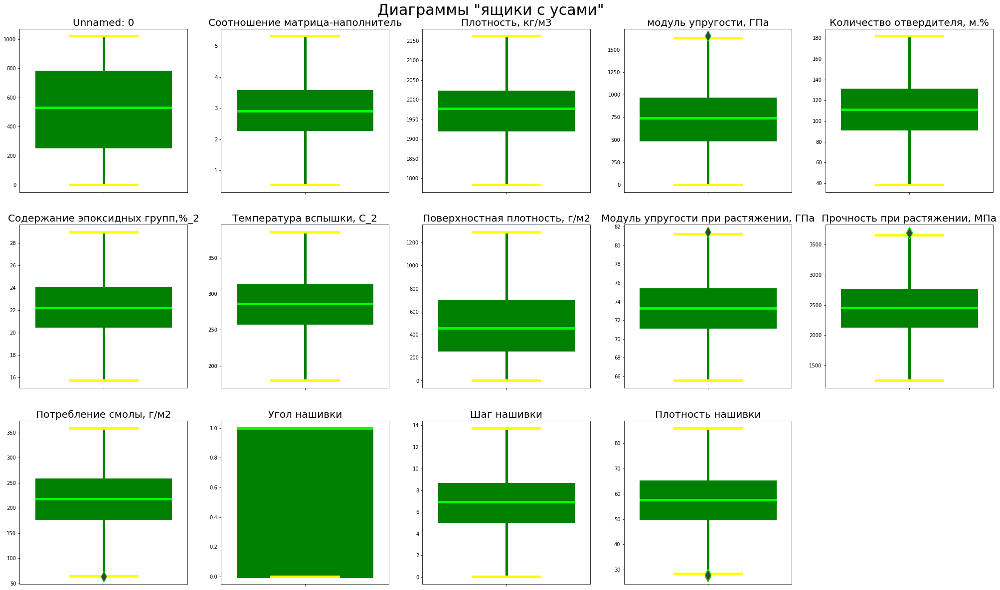

In [16]:
a = 5 # количество строк
b = 5 # количество столцбцов
c = 1 # инициализация plot counter
plt.figure(figsize = (35,35))
plt.suptitle('Диаграммы "ящики с усами"', y = 0.9 ,
 fontsize = 30)
for col in df.columns:
    plt.subplot(a, b, c)
#plt.figure(figsize=(7,5))
    sns.boxplot(data = df, y = df[col], fliersize = 15, linewidth = 5, boxprops = dict(facecolor = 'y', color = 'g'), medianprops = dict(color = 'lime'), whiskerprops = dict(color = "g"), capprops = dict(color="yellow"), flierprops = dict(color = "y", markeredgecolor = "lime"))
    plt.ylabel(None)
    plt.title(col, size = 20)
#plt.show()
    c += 1

наблюдаем все еще наличие выбросов

Посмотрим на "ящики с усами",чтобы наглядно увидеть, что выбросов нет, но они есть

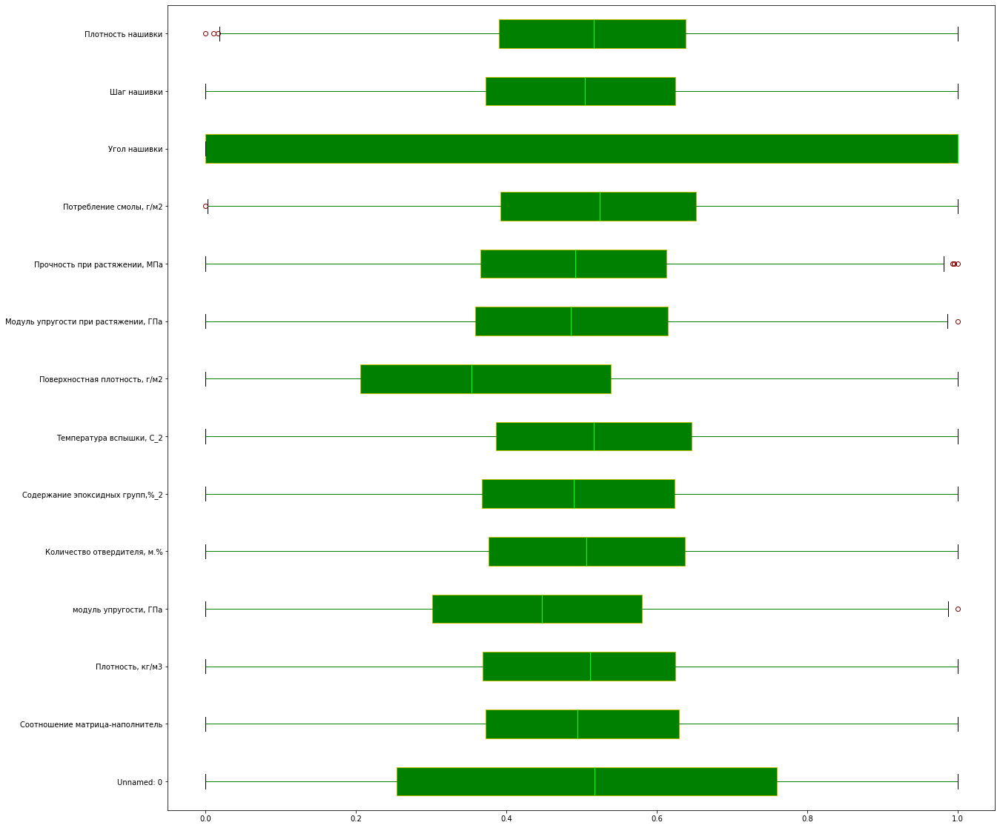

In [17]:
scaler = MinMaxScaler()
scaler.fit(df)
plt.figure(figsize = (20, 20))
plt.boxplot(pd.DataFrame(scaler.transform(df)), labels = df.columns,patch_artist = True, meanline = True, vert = False, boxprops = dict(facecolor = 'g', color = 'y'),medianprops = dict(color = 'lime'), whiskerprops = dict(color = "g"), capprops = dict(color = "black"), flierprops = dict(color = "y", markeredgecolor = "maroon"))
plt.show()

На графиках выше мы видим выбросы в некоторых столбцах. Они всё ещё есть, поэтому повторяем удаление выбросов

In [18]:
for i in column_list_drop:
    q75, q25 = np.percentile(df.loc[:,i],[75, 25])
    intr_qr = q75 - q25
    max = q75 + (1.5 * intr_qr)
    min = q25 - (1.5 * intr_qr)
    df.loc[df[i] < min, i] = np.nan
    df.loc[df[i] > max, i] = np.nan

Ящики с усами (второй вариант)

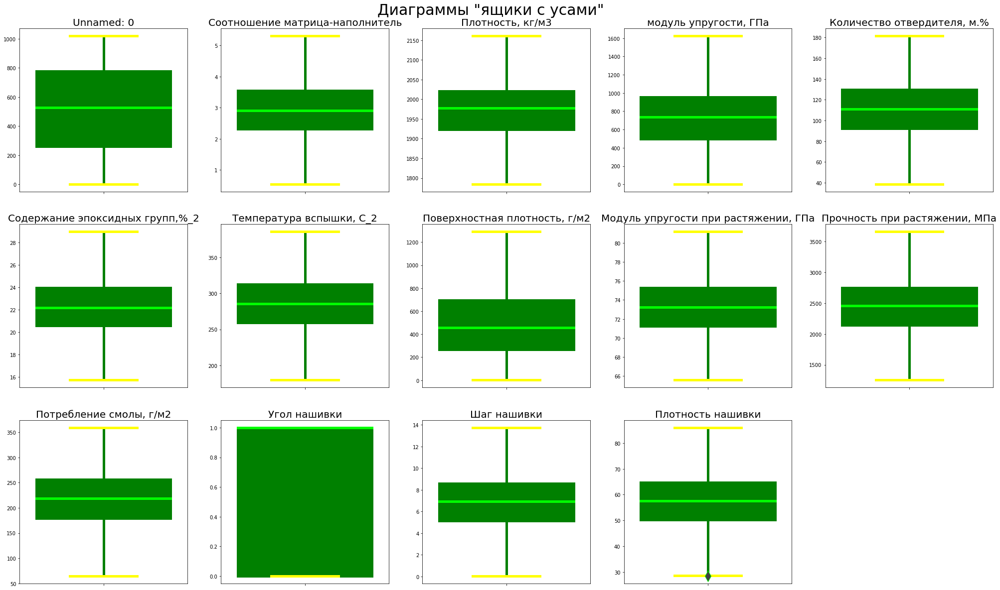

In [19]:
a = 5 # количество строк
b = 5 # количество столцбцов
c = 1 # инициализация plot counter
plt.figure(figsize=(35,35))
plt.suptitle('Диаграммы "ящики с усами"', y = 0.9 ,
 fontsize = 30)
for col in df.columns:
    plt.subplot(a, b, c)
 #plt.figure(figsize=(7,5))
    sns.boxplot(data = df, y = df[col], fliersize = 15, linewidth = 5, boxprops = dict(facecolor = 'y', color = 'g'), medianprops = dict(color = 'lime'), whiskerprops = dict(color = "g"), capprops = dict(color="yellow"), flierprops = dict(color = "y", markeredgecolor = "lime"))
    plt.ylabel(None)
    plt.title(col, size = 20)
 #plt.show()
    c += 1

ассиметрия по всем колонкам.

In [20]:
df.skew()

Unnamed: 0                             -0.039867
Соотношение матрица-наполнитель         0.058917
Плотность, кг/м3                        0.002822
модуль упругости, ГПа                   0.070329
Количество отвердителя, м.%            -0.120959
Содержание эпоксидных групп,%_2         0.027075
Температура вспышки, С_2                0.007521
Поверхностная плотность, г/м2           0.357603
Модуль упругости при растяжении, ГПа    0.103130
Прочность при растяжении, МПа           0.063061
Потребление смолы, г/м2                -0.026155
Угол нашивки                           -0.047097
Шаг нашивки                             0.051818
Плотность нашивки                      -0.047335
dtype: float64

эксцесс по всем колонкам.

In [21]:
df.kurt()

Unnamed: 0                             -1.209355
Соотношение матрица-наполнитель        -0.308087
Плотность, кг/м3                       -0.215627
модуль упругости, ГПа                  -0.373035
Количество отвердителя, м.%            -0.249075
Содержание эпоксидных групп,%_2        -0.318102
Температура вспышки, С_2               -0.307474
Поверхностная плотность, г/м2          -0.548925
Модуль упругости при растяжении, ГПа   -0.308785
Прочность при растяжении, МПа          -0.217998
Потребление смолы, г/м2                -0.398795
Угол нашивки                           -2.002064
Шаг нашивки                            -0.114436
Плотность нашивки                      -0.193072
dtype: float64

Проверим сумму выбросов по каждому из столбцов

In [22]:
df.isnull().sum()

Unnamed: 0                              0
Соотношение матрица-наполнитель         0
Плотность, кг/м3                        0
модуль упругости, ГПа                   1
Количество отвердителя, м.%             0
Содержание эпоксидных групп,%_2         0
Температура вспышки, С_2                0
Поверхностная плотность, г/м2           0
Модуль упругости при растяжении, ГПа    1
Прочность при растяжении, МПа           4
Потребление смолы, г/м2                 1
Угол нашивки                            0
Шаг нашивки                             0
Плотность нашивки                       3
dtype: int64

И снова удаляем строки, которые содержат выбросы

In [23]:
df = df.dropna(axis=0)

Третий раз проверим сумму выбросов по каждому столбцу

In [24]:
df.isnull().sum()

Unnamed: 0                              0
Соотношение матрица-наполнитель         0
Плотность, кг/м3                        0
модуль упругости, ГПа                   0
Количество отвердителя, м.%             0
Содержание эпоксидных групп,%_2         0
Температура вспышки, С_2                0
Поверхностная плотность, г/м2           0
Модуль упругости при растяжении, ГПа    0
Прочность при растяжении, МПа           0
Потребление смолы, г/м2                 0
Угол нашивки                            0
Шаг нашивки                             0
Плотность нашивки                       0
dtype: int64

Просмотрим информацию о нашем датасете после еще одного удаления пропусков.

In [25]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 926 entries, 1 to 1022
Data columns (total 14 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   Unnamed: 0                            926 non-null    int64  
 1   Соотношение матрица-наполнитель       926 non-null    float64
 2   Плотность, кг/м3                      926 non-null    float64
 3   модуль упругости, ГПа                 926 non-null    float64
 4   Количество отвердителя, м.%           926 non-null    float64
 5   Содержание эпоксидных групп,%_2       926 non-null    float64
 6   Температура вспышки, С_2              926 non-null    float64
 7   Поверхностная плотность, г/м2         926 non-null    float64
 8   Модуль упругости при растяжении, ГПа  926 non-null    float64
 9   Прочность при растяжении, МПа         926 non-null    float64
 10  Потребление смолы, г/м2               926 non-null    float64
 11  Угол нашивки      

В третий раз построим на "ящики с усами"

Выводим "ящики"

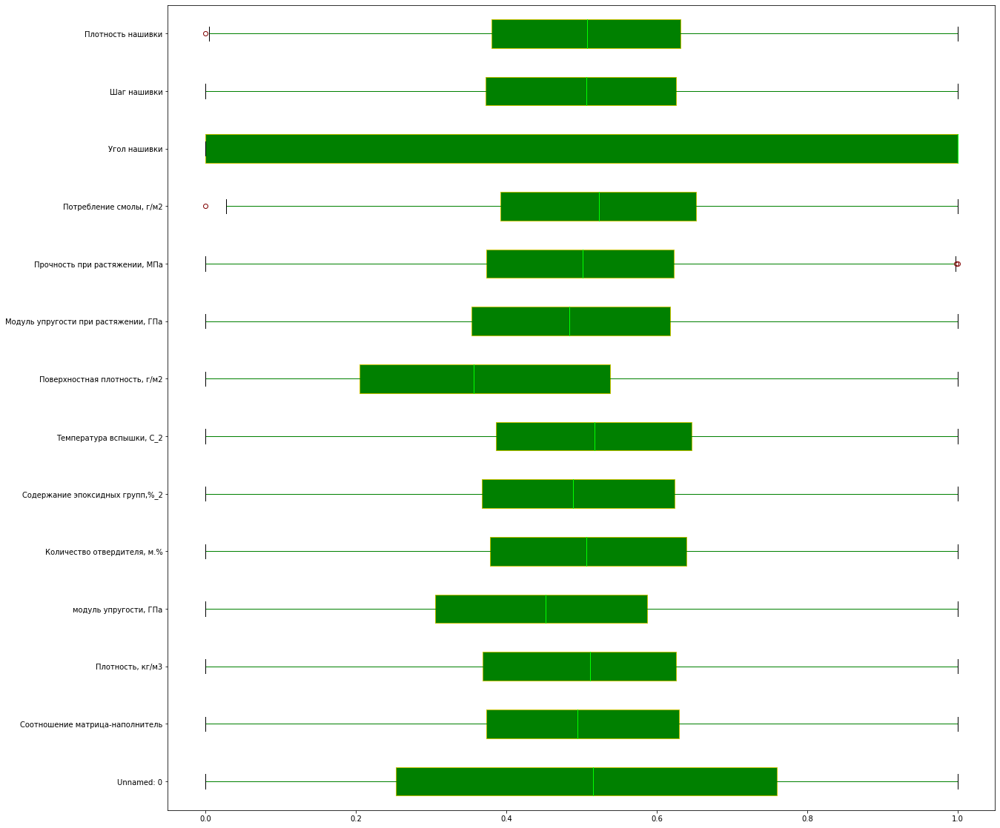

In [26]:
scaler = MinMaxScaler()
scaler.fit(df)
plt.figure(figsize = (20, 20))
plt.boxplot(pd.DataFrame(scaler.transform(df)), labels = df.columns,patch_artist = True, meanline = True, vert = False, boxprops = dict(facecolor = 'g', color = 'y'),medianprops = dict(color = 'lime'), whiskerprops = dict(color = "g"), capprops = dict(color = "black"), flierprops = dict(color = "y", markeredgecolor = "maroon"))
plt.show()

Ящики с усами (второй вариант)

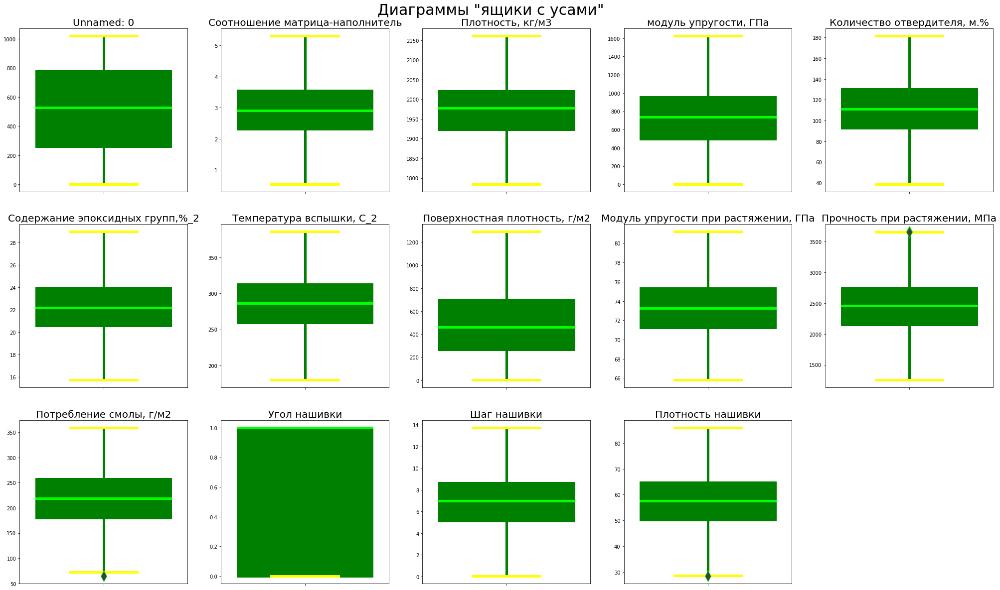

In [27]:
a = 5 # количество строк
b = 5 # количество столцбцов
c = 1 # инициализация plot counter
plt.figure(figsize = (35,35))
plt.suptitle('Диаграммы "ящики с усами"', y = 0.9 ,
 fontsize = 30)
for col in df.columns:
    plt.subplot(a, b, c)
#plt.figure(figsize=(7,5))
    sns.boxplot(data = df, y = df[col], fliersize = 15, linewidth = 5, boxprops = dict(facecolor = 'y', color = 'g'), medianprops = dict(color = 'lime'), whiskerprops = dict(color = "g"), capprops = dict(color = "yellow"), flierprops = dict(color = "y", markeredgecolor = "lime"))
    plt.ylabel(None)
    plt.title(col, size = 20)
#plt.show()
    c += 1


И снова видим, что выбросы остались в некоторых исходных данных.

Повторяем процедуру с выбросами еще раз. Надеюсь последний

In [28]:
for i in column_list_drop:
    q75, q25 = np.percentile(df.loc[:,i],[75, 25])
    intr_qr = q75 - q25
    max = q75 + (1.5*intr_qr)
    min = q25 - (1.5*intr_qr)
    df.loc[df[i] < min,i] = np.nan
    df.loc[df[i] > max,i] = np.nan

Еще раз проверим сумму выбросов в каждом столбце

In [29]:
df.isnull().sum()

Unnamed: 0                              0
Соотношение матрица-наполнитель         0
Плотность, кг/м3                        0
модуль упругости, ГПа                   0
Количество отвердителя, м.%             0
Содержание эпоксидных групп,%_2         0
Температура вспышки, С_2                0
Поверхностная плотность, г/м2           0
Модуль упругости при растяжении, ГПа    0
Прочность при растяжении, МПа           2
Потребление смолы, г/м2                 1
Угол нашивки                            0
Шаг нашивки                             0
Плотность нашивки                       1
dtype: int64

Еще раз удаляем строки с выбросами

In [30]:
df = df.dropna(axis=0)

И проверочно посмотрим сумму выбросов

In [31]:
df.isnull().sum()

Unnamed: 0                              0
Соотношение матрица-наполнитель         0
Плотность, кг/м3                        0
модуль упругости, ГПа                   0
Количество отвердителя, м.%             0
Содержание эпоксидных групп,%_2         0
Температура вспышки, С_2                0
Поверхностная плотность, г/м2           0
Модуль упругости при растяжении, ГПа    0
Прочность при растяжении, МПа           0
Потребление смолы, г/м2                 0
Угол нашивки                            0
Шаг нашивки                             0
Плотность нашивки                       0
dtype: int64

Просмотрим на чистый датасет

In [32]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 922 entries, 1 to 1022
Data columns (total 14 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   Unnamed: 0                            922 non-null    int64  
 1   Соотношение матрица-наполнитель       922 non-null    float64
 2   Плотность, кг/м3                      922 non-null    float64
 3   модуль упругости, ГПа                 922 non-null    float64
 4   Количество отвердителя, м.%           922 non-null    float64
 5   Содержание эпоксидных групп,%_2       922 non-null    float64
 6   Температура вспышки, С_2              922 non-null    float64
 7   Поверхностная плотность, г/м2         922 non-null    float64
 8   Модуль упругости при растяжении, ГПа  922 non-null    float64
 9   Прочность при растяжении, МПа         922 non-null    float64
 10  Потребление смолы, г/м2               922 non-null    float64
 11  Угол нашивки      

"Ящики с усами"(боксплоты) (первый вариант)

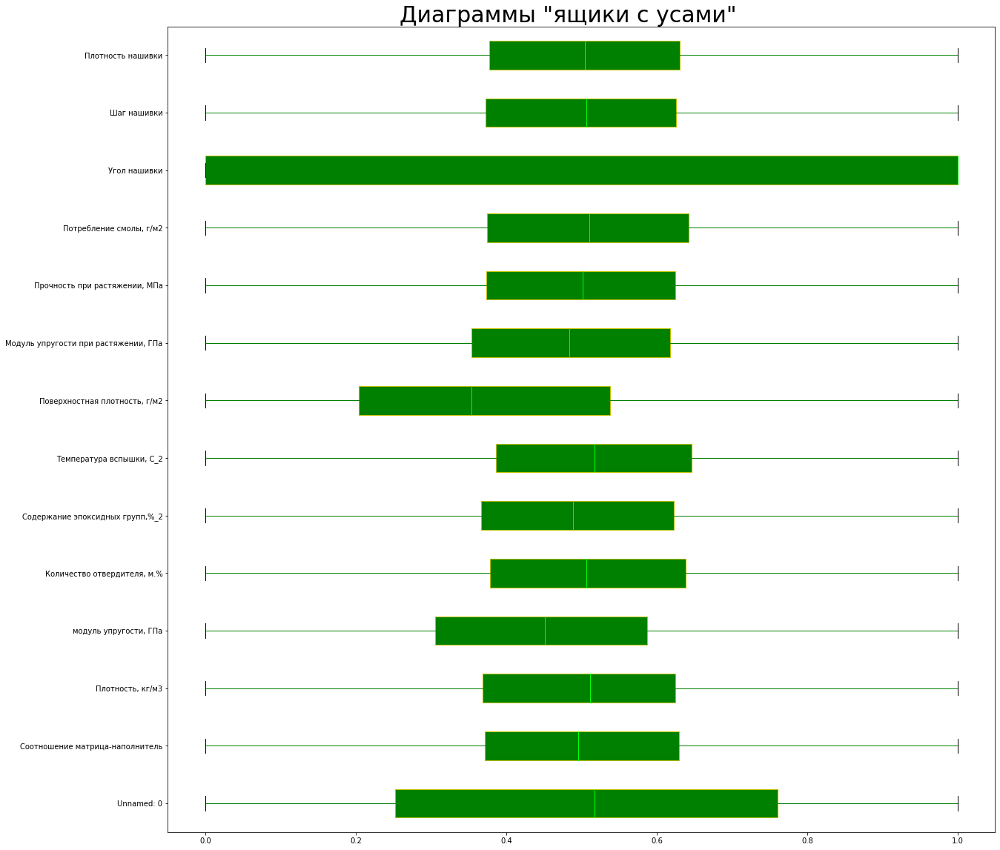

In [33]:
scaler = MinMaxScaler()
scaler.fit(df)
plt.figure(figsize = (20, 20))
plt.suptitle('Диаграммы "ящики с усами"', y = 0.9 ,
 fontsize = 30)
plt.boxplot(pd.DataFrame(scaler.transform(df)), labels = df.columns,patch_artist = True, meanline = True, vert = False, boxprops = dict(facecolor = 'g', color = 'y'),medianprops = dict(color = 'lime'), whiskerprops = dict(color = "g"), capprops = dict(color = "black"), flierprops = dict(color = "y", markeredgecolor = "maroon"))
plt.show()

Ящики с усами (второй вариант)

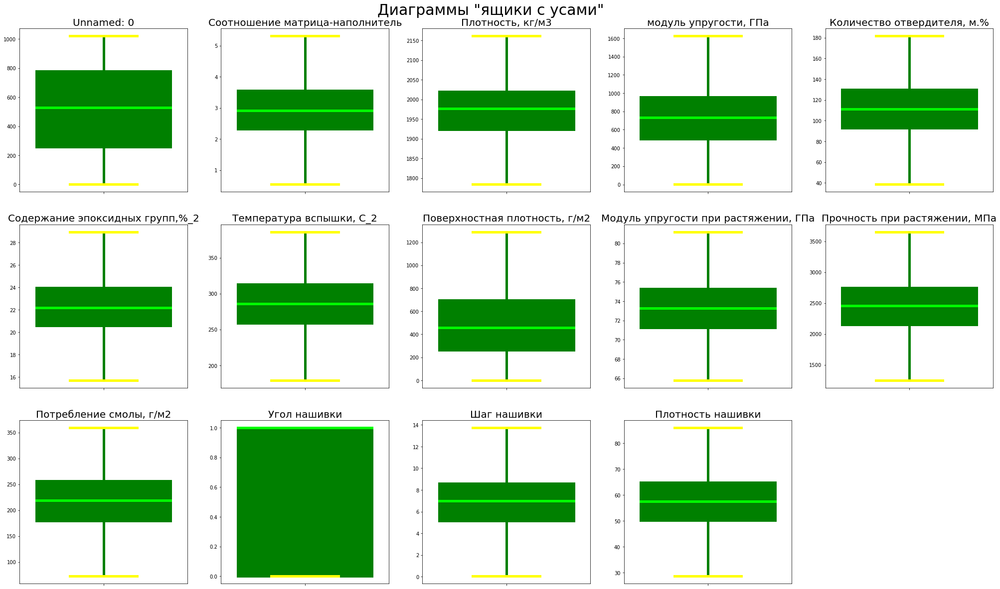

In [34]:
a = 5 # количество строк
b = 5 # количество столцбцов
c = 1 # инициализация plot counter
plt.figure(figsize = (35,35))
plt.suptitle('Диаграммы "ящики с усами"', y = 0.9 ,
fontsize = 30)
for col in df.columns:
    plt.subplot(a, b, c)
#plt.figure(figsize=(7,5))
    sns.boxplot(data = df, y = df[col], fliersize = 15, linewidth = 5, boxprops = dict(facecolor = 'y', color = 'g'), medianprops = dict(color = 'lime'), whiskerprops = dict(color = "g"), capprops = dict(color = "yellow"), flierprops = dict(color = "y", markeredgecolor = "lime"))
    plt.ylabel(None)
    plt.title(col, size = 20)
#plt.show()
    c += 1

Построим гистограммы распределения каждой из переменных без нормализации

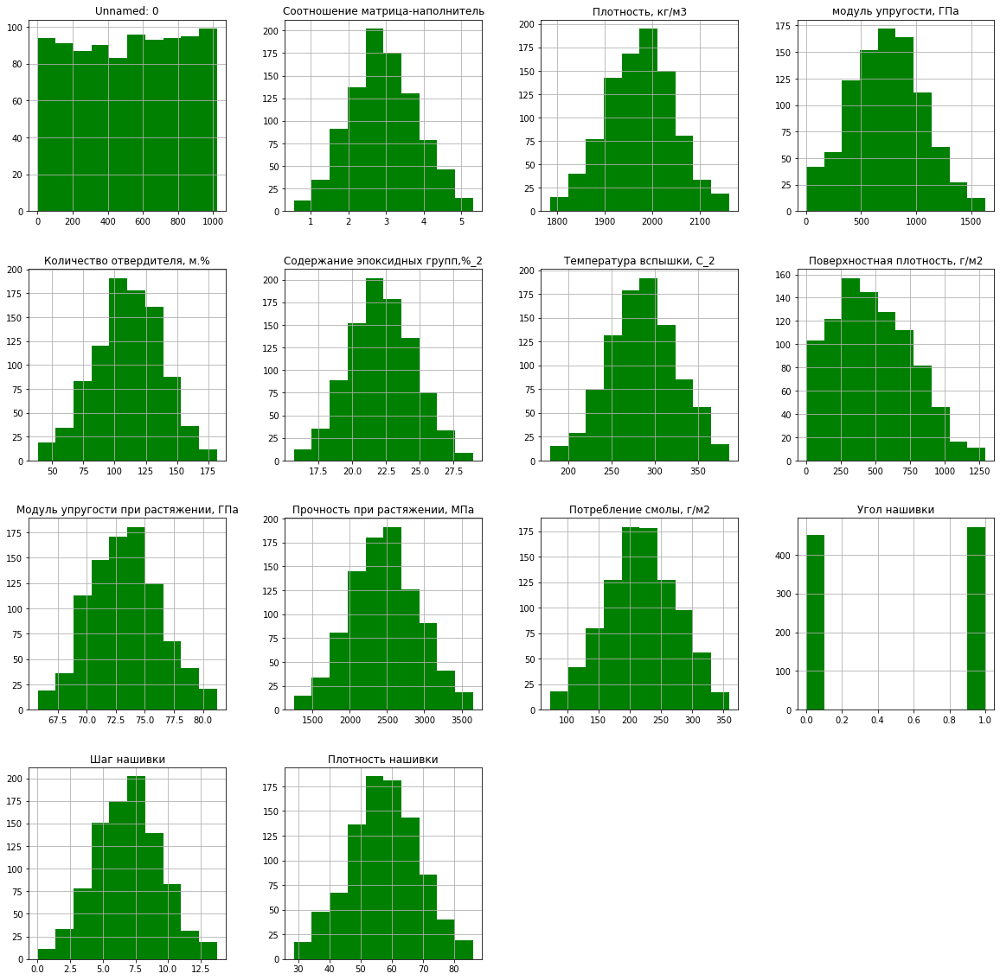

In [35]:
df.hist(figsize = (20,20), color = "g")
plt.show()

Гистограмма распределения (второй вариант)

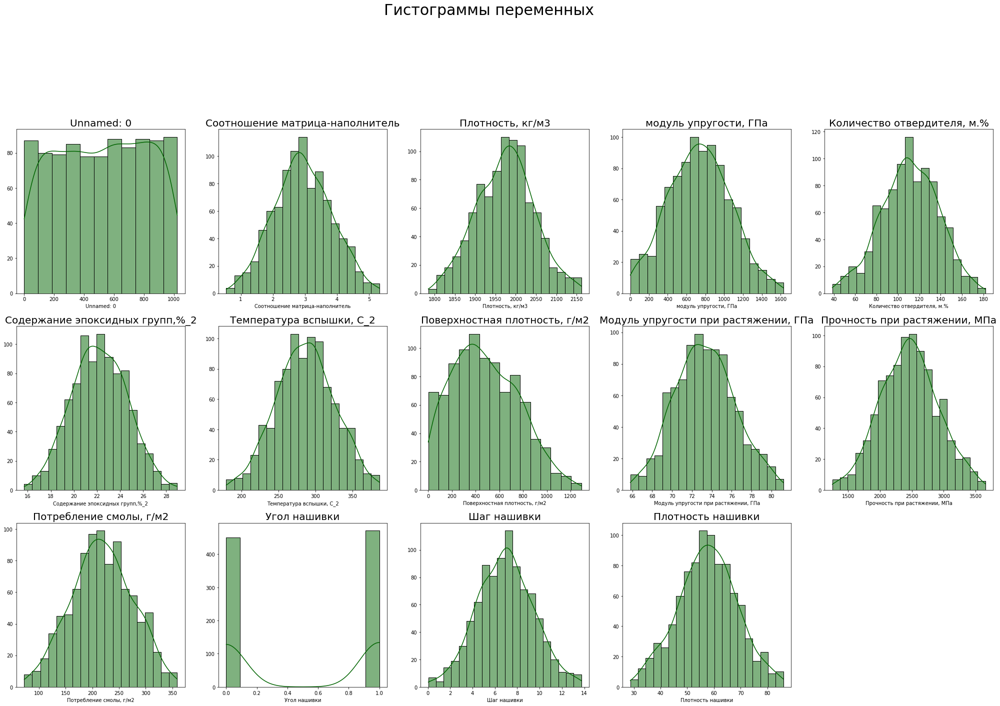

In [36]:
a = 5 # количество строк
b = 5 # количество столцбцов
c = 1 # инициализация plot counter
plt.figure(figsize=(35,35))
plt.suptitle('Гистограммы переменных', fontsize = 30)
for col in df.columns:
 plt.subplot(a, b, c)
 #plt.figure(figsize=(7,5))
 sns.histplot(data = df[col], kde = True, color = "darkgreen")
 plt.ylabel(None)
 plt.title(col, size = 20)
 #plt.show()
 c += 1 

Данные стремятся к нормальному распределению практически везде, кроме угла нашивки, имеющим только 2 значения,
с которым мы уже поработали ранее.

гистограмма распределения и боксплоты (третий вариант)

In [37]:
for column in df.columns:
    fig = px.histogram(df, x=column, color_discrete_sequence=['green'], nbins=100, marginal="box")
    fig.show()

In [38]:
for column in df.columns:
    fig = px.box(df, y=column)
    fig.show()

# Ящики с усами на одном рисунке

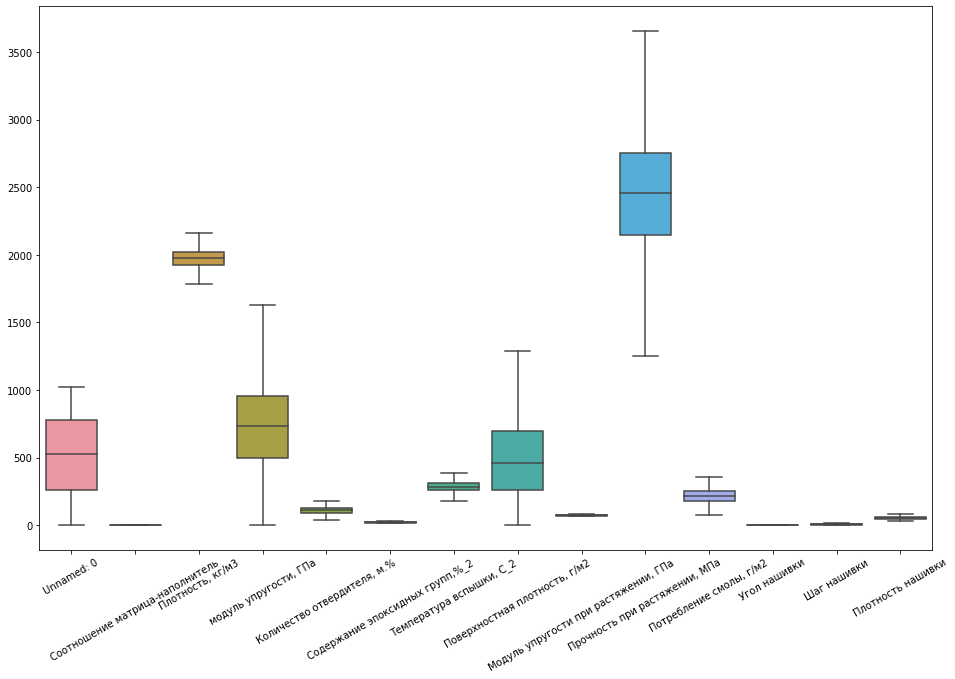

In [39]:
plt.figure(figsize=(16,10))
ax = sns.boxplot(data=df)
ax.set_xticklabels(ax.get_xticklabels(),rotation=30);

часть кода выше не работает в колабе, поэтому выбросы проверим еще другими способами

Unnamed: 0
Соотношение матрица-наполнитель
Плотность, кг/м3
модуль упругости, ГПа
Количество отвердителя, м.%
Содержание эпоксидных групп,%_2
Температура вспышки, С_2
Поверхностная плотность, г/м2
Модуль упругости при растяжении, ГПа
Прочность при растяжении, МПа
Потребление смолы, г/м2
Угол нашивки
Шаг нашивки
Плотность нашивки


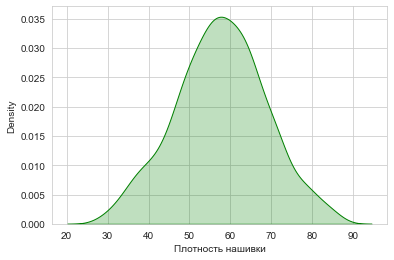

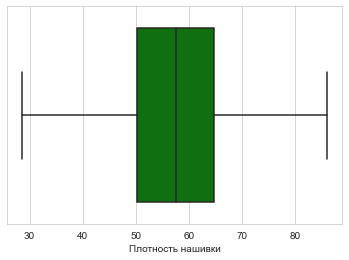

Минимальное значение:  

In [40]:
for column_name in column_names:
    print(column_name)
 
 #Гистограмма распределения
gis = df[column_name]
sns.set_style("whitegrid")
sns.kdeplot(data = gis, shade = True, palette = 'colorblind', color = "g")
plt.show()
 
 #Диаграмма "Ящик с усами"
sns.boxplot(x = gis, color = "g");
plt.show()
 
 #Значения (мин макс ср)
print("Минимальное значение: ", end = " ")

In [41]:
print(np.min(gis))
print("Максимальное значение: ", end = " ")
print(np.max(gis))
print("Среднее значение: ", end = " ")
print(np.mean(gis))
print("Медианное значение: ", end = " ")
print(np.median(gis))
print("\n\n")

28.6616316278123
Максимальное значение:  86.0124270098611
Среднее значение:  57.56288675591675
Медианное значение:  57.584224985771854





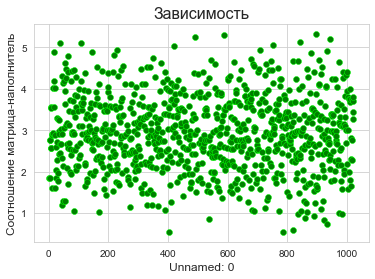

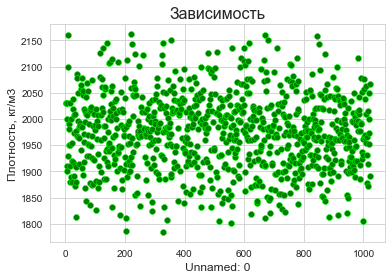

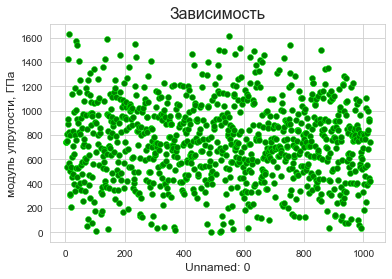

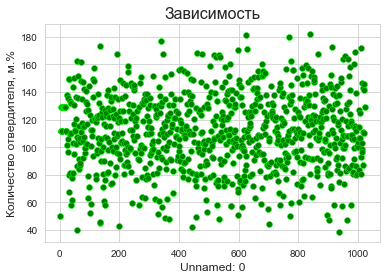

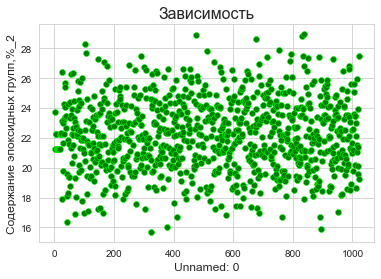

...

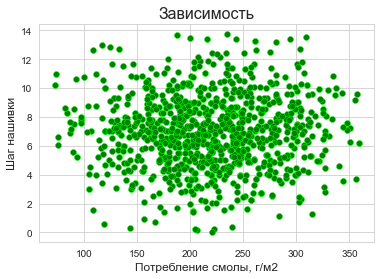

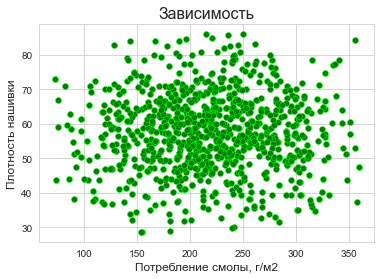

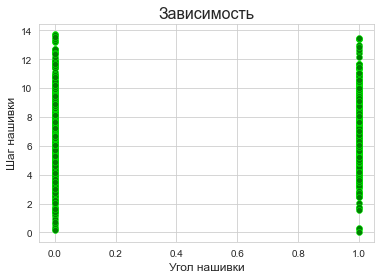

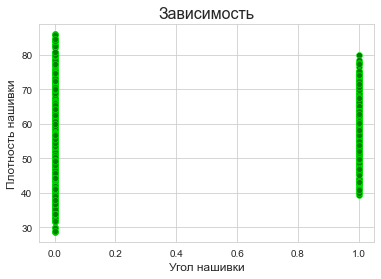

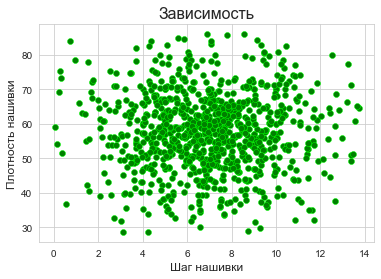

In [42]:
n = 0
while n < len(column_names):
    b = n + 1
    while b < len(column_names):
        sns.set_style('whitegrid')
        plt.title('Зависимость',size = 16)
        plt.xlabel(column_names[n],size = 12)
        plt.ylabel(column_names[b],size = 12)
        sns.scatterplot(x = column_names[n], y = column_names[b], data = df, color = "green", edgecolor = 'lime', palette = 'cubehelix')
        plt.show()
        b += 1
    n += 1

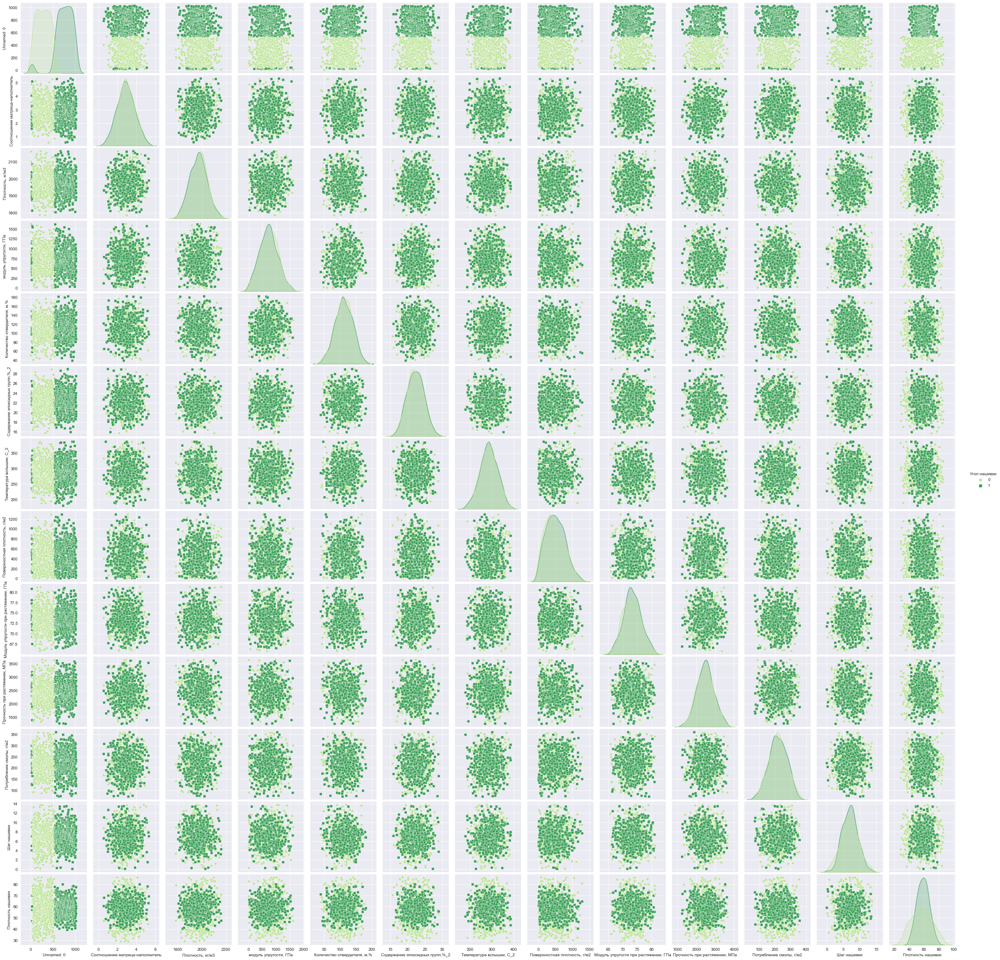

In [43]:
sns.set_style('darkgrid')
sns.pairplot(df, hue = 'Угол нашивки', markers = ["o", "s"], diag_kind = 'auto', palette = 'YlGn')

Попарные графики рассеяния точек - скаттерплоты (второй вариант)

<function matplotlib.pyplot.show(close=None, block=None)>

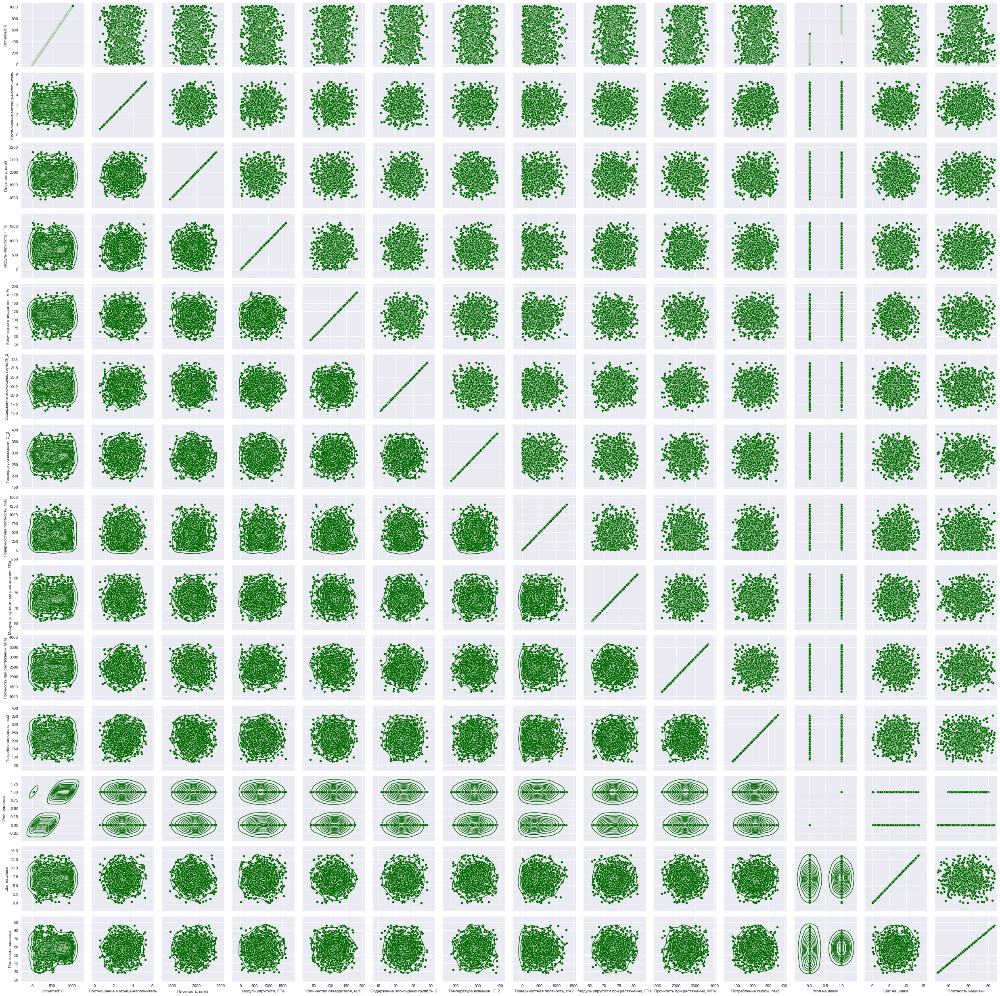

In [44]:
g = sns.PairGrid(df[df.columns])
g.map(sns.scatterplot, color = 'darkgreen')
g.map_upper(sns.scatterplot, color = 'darkgreen')
g.map_lower(sns.kdeplot, color = 'darkgreen')
plt.show

Корреляции нет

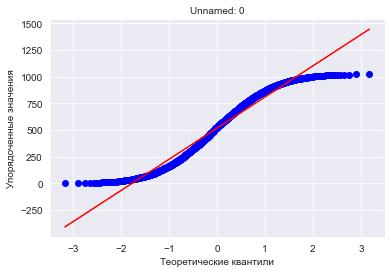

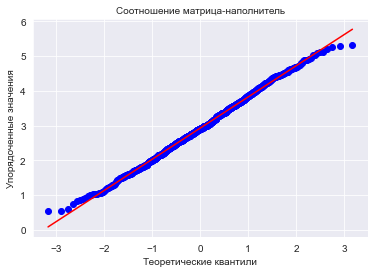

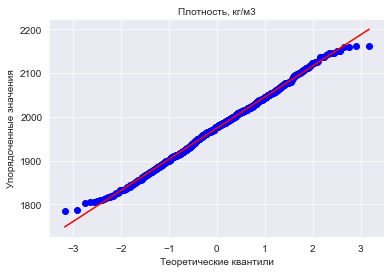

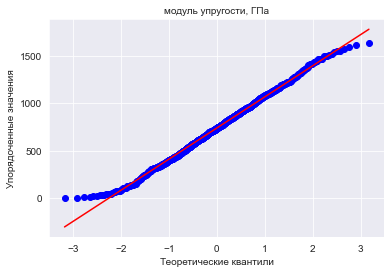

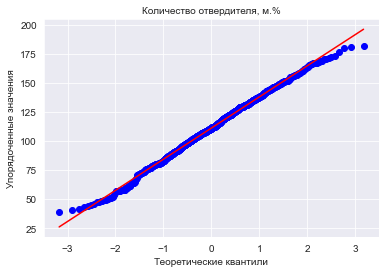

...

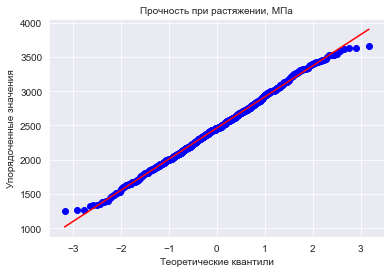

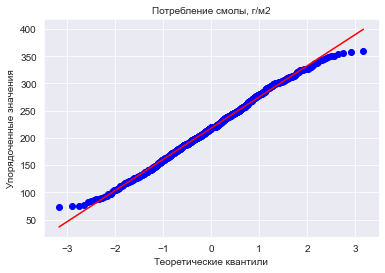

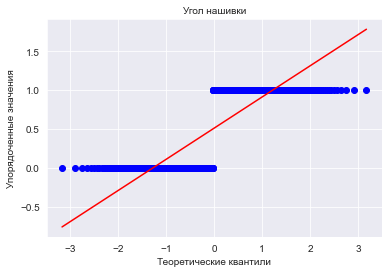

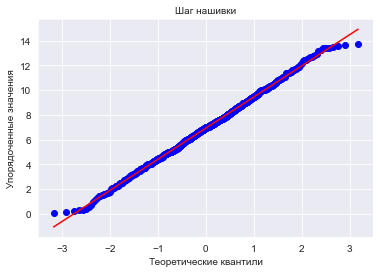

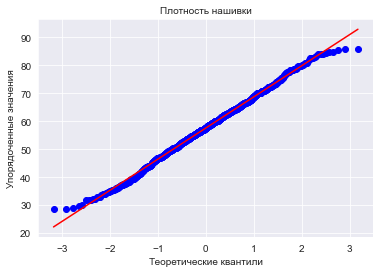

In [45]:
for i in df.columns:
    plt.figure(figsize = (6, 4))
    res = stats.probplot(df[i], plot = plt)
    plt.title(i, fontsize = 10)
    plt.xlabel("Теоретические квантили", fontsize = 10)
    plt.ylabel("Упорядоченные значения", fontsize = 10)
    plt.show()

Визуализация корреляционной матрицы с помощью тепловой карты.
Создаем полотно для отображения большого графика.
Визуализируем данные кореляции и создаем цветовую политру

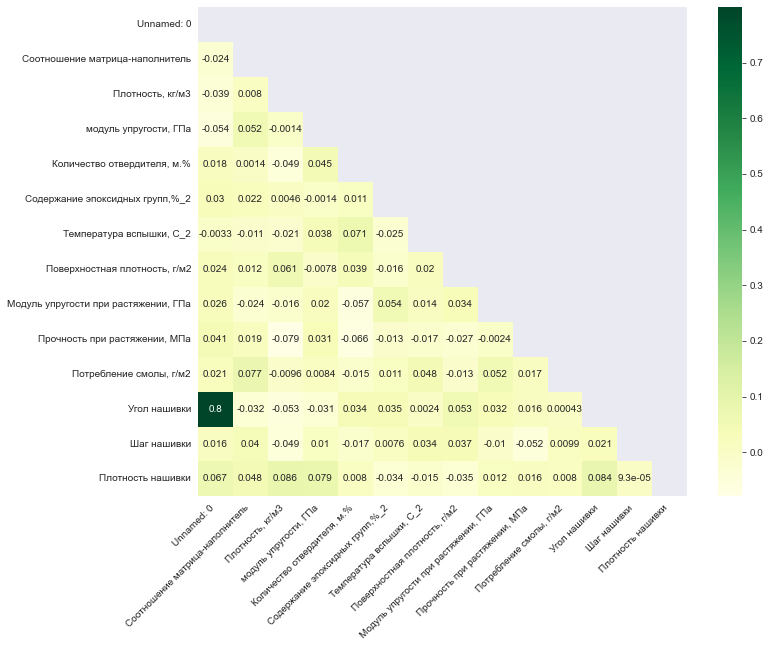

In [46]:
mask = np.triu(df.corr())
f, ax = plt.subplots(figsize=(11, 9))
sns.heatmap(df.corr(), mask = mask, annot = True, square = True, cmap = 'YlGn')
plt.xticks(rotation = 45, ha = 'right')
plt.show()

наконец-то, убеждаемся, что выбросов не осталось. В итоге осталось всего 922 строки 

In [47]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 922 entries, 1 to 1022
Data columns (total 14 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   Unnamed: 0                            922 non-null    int64  
 1   Соотношение матрица-наполнитель       922 non-null    float64
 2   Плотность, кг/м3                      922 non-null    float64
 3   модуль упругости, ГПа                 922 non-null    float64
 4   Количество отвердителя, м.%           922 non-null    float64
 5   Содержание эпоксидных групп,%_2       922 non-null    float64
 6   Температура вспышки, С_2              922 non-null    float64
 7   Поверхностная плотность, г/м2         922 non-null    float64
 8   Модуль упругости при растяжении, ГПа  922 non-null    float64
 9   Прочность при растяжении, МПа         922 non-null    float64
 10  Потребление смолы, г/м2               922 non-null    float64
 11  Угол нашивки      

Сохраняем идеальный, без выбросов датасет, чтобы в excel проверить дополнительно

In [48]:
df.to_csv('Itog\Itog.csv', encoding = 'cp1251' )
df.to_excel("Itog\Itog.xlsx")

Проводим повторный разведочный анализ уже без выбросов

Выведем корреляции между параметрами

In [49]:
df.corr()

,Unnamed: 0,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
Unnamed: 0,1.000000,-0.024374,-0.039229,-0.054259,0.017996,0.029789,-0.003255,0.024305,0.025623,0.041208,0.021012,0.799537,0.016178,0.067496
Соотношение матрица-наполнитель,-0.024374,1.000000,0.007996,0.051643,0.001353,0.021982,-0.010565,0.011910,-0.024316,0.019141,0.076857,-0.032144,0.039924,0.047835
"Плотность, кг/м3",-0.039229,0.007996,1.000000,-0.001416,-0.048938,0.004568,-0.021256,0.061496,-0.015597,-0.079188,-0.009609,-0.052993,-0.048648,0.086460
"модуль упругости, ГПа",-0.054259,0.051643,-0.001416,1.000000,0.044550,-0.001442,0.037622,-0.007805,0.020063,0.031041,0.008368,-0.031490,0.010238,0.078810
"Количество отвердителя, м.%",0.017996,0.001353,-0.048938,0.044550,1.000000,0.011429,0.070623,0.038762,-0.057026,-0.065711,-0.014827,0.034103,-0.017394,0.007981
"Содержание эпоксидных групп,%_2",0.029789,0.021982,0.004568,-0.001442,0.011429,1.000000,-0.025315,-0.015844,0.053887,-0.013099,0.010808,0.034520,0.007571,-0.034481
"Температура вспышки, С_2",-0.003255,-0.010565,-0.021256,0.037622,0.070623,-0.025315,1.000000,0.020307,0.014168,-0.017263,0.048142,0.002371,0.034395,-0.015014
"Поверхностная плотность, г/м2",0.024305,0.011910,0.061496,-0.007805,0.038762,-0.015844,0.020307,1.000000,0.033526,-0.027320,-0.012606,0.053180,0.036931,-0.034989
"Модуль упругости при растяжении, ГПа",0.025623,-0.024316,-0.015597,0.020063,-0.057026,0.053887,0.014168,0.033526,1.000000,-0.002393,0.051676,0.031910,-0.010193,0.012488
"Прочность при растяжении, МПа",0.041208,0.019141,-0.079188,0.031041,-0.065711,-0.013099,-0.017263,-0.027320,-0.002393,1.000000,0.016753,0.016144,-0.051580,0.016311


Посмотрим на средние и медианные знчения датасета после выбросов.

In [50]:
mean_and_50 = df.describe()
mean_and_50.loc[['mean', '50%']]

,Unnamed: 0,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
mean,518.643167,2.927964,1974.118744,736.119982,111.136066,22.200570,286.181128,482.429070,73.303464,2461.491315,218.048059,0.510846,6.931939,57.562887
50%,529.000000,2.907832,1977.321002,736.178435,111.162090,22.177681,286.220763,457.732246,73.247594,2455.974462,218.697660,1.000000,6.972862,57.584225


Убедимся, что после удаления выбросов среднее и медианное значение остались в пределах предыдущих значений.

Приготовим переменные и проверим данные перед нормализацией данных

In [51]:
df_norm = df.copy()

In [52]:
df_norm.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 922 entries, 1 to 1022
Data columns (total 14 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   Unnamed: 0                            922 non-null    int64  
 1   Соотношение матрица-наполнитель       922 non-null    float64
 2   Плотность, кг/м3                      922 non-null    float64
 3   модуль упругости, ГПа                 922 non-null    float64
 4   Количество отвердителя, м.%           922 non-null    float64
 5   Содержание эпоксидных групп,%_2       922 non-null    float64
 6   Температура вспышки, С_2              922 non-null    float64
 7   Поверхностная плотность, г/м2         922 non-null    float64
 8   Модуль упругости при растяжении, ГПа  922 non-null    float64
 9   Прочность при растяжении, МПа         922 non-null    float64
 10  Потребление смолы, г/м2               922 non-null    float64
 11  Угол нашивки      

# Предобработка данных.

Нормализуем данные.

У нас в основном количественные признаки, поэтому можно применить нормализацию (приведение в диапазон от 0 до 1)
или стандартизацию (приведение к матожиданию 0, стандартному отклонению 1).
Т.к. это в том числе учебная работа, то используем и нормализацию, и стандартизацию.
Этап предобработки данных нужен нам и для введенных данных в будущем приложении, которое явится результатом нашей работы.

На данный момент в нашем датасете всего 922 строки. Они все без выбросов и без пропущенных значений, все имеют int или float.

<AxesSubplot:ylabel='Density'>

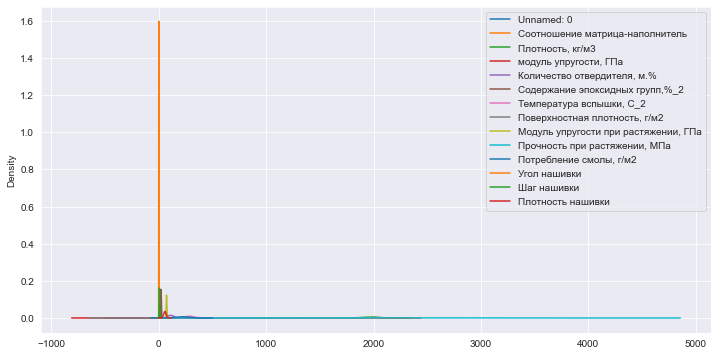

In [53]:
fig, ax = plt.subplots(figsize = (12, 6))
df_norm.plot(kind = 'kde', ax = ax)

Оценка плотности ядра показывает, что наши данные находятся в разных диапазонах.
А в связи с тем, что диапазоны очень разные, данные нужно нормализовать. Можем приступать к нормализации данных.

Нормализуем данные с помощью MinMaxScaler()

In [54]:
scaler = preprocessing.MinMaxScaler()
col = df.columns
result = scaler.fit_transform(df)
df_minmax_n = pd.DataFrame(result, columns = col)
df_minmax_n.describe()

,Unnamed: 0,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
count,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000
mean,0.506996,0.499412,0.502904,0.451341,0.506200,0.490578,0.516739,0.373295,0.487343,0.503776,0.507876,0.510846,0.503426,0.503938
std,0.291686,0.187858,0.188395,0.201534,0.186876,0.180548,0.190721,0.217269,0.196366,0.188668,0.199418,0.500154,0.183587,0.193933
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.251959,0.371909,0.368184,0.305188,0.378514,0.366571,0.386228,0.204335,0.353512,0.373447,0.374647,0.000000,0.372844,0.376869
50%,0.517140,0.495189,0.511396,0.451377,0.506382,0.488852,0.516931,0.354161,0.483718,0.501481,0.510143,1.000000,0.506414,0.504310
75%,0.760774,0.629774,0.624719,0.587193,0.638735,0.623046,0.646553,0.538397,0.617568,0.624299,0.642511,1.000000,0.626112,0.630842
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


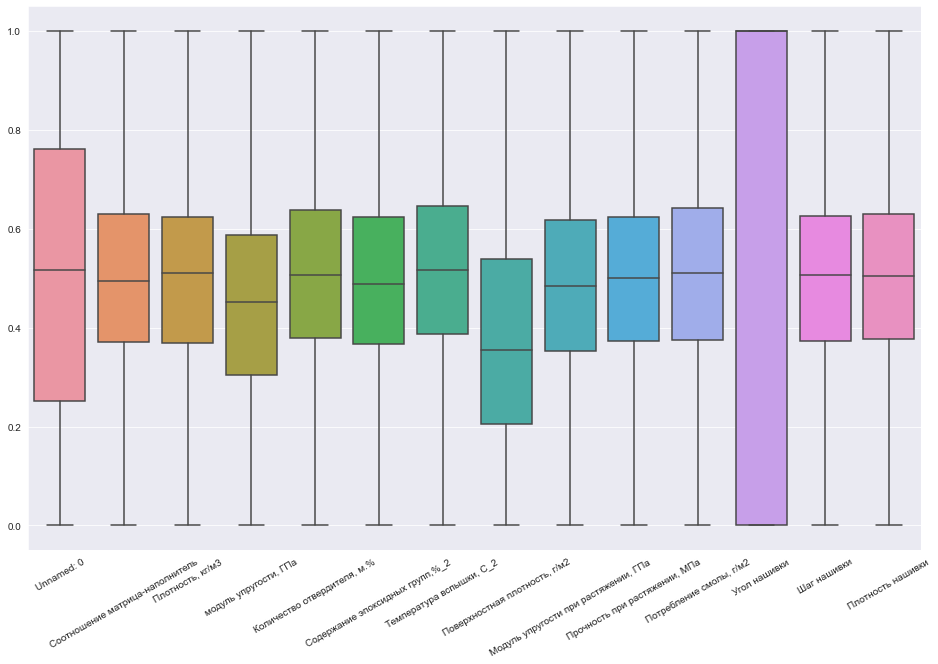

In [55]:
plt.figure(figsize = (16,10))
ax = sns.boxplot(data = df_minmax_n)
ax.set_xticklabels(ax.get_xticklabels(),rotation=30);

<AxesSubplot:ylabel='Density'>

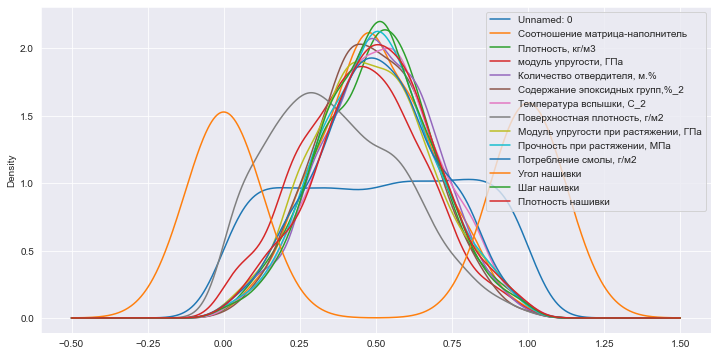

In [56]:
fig, ax = plt.subplots(figsize = (12, 6))
df_minmax_n.plot(kind = 'kde', ax = ax)

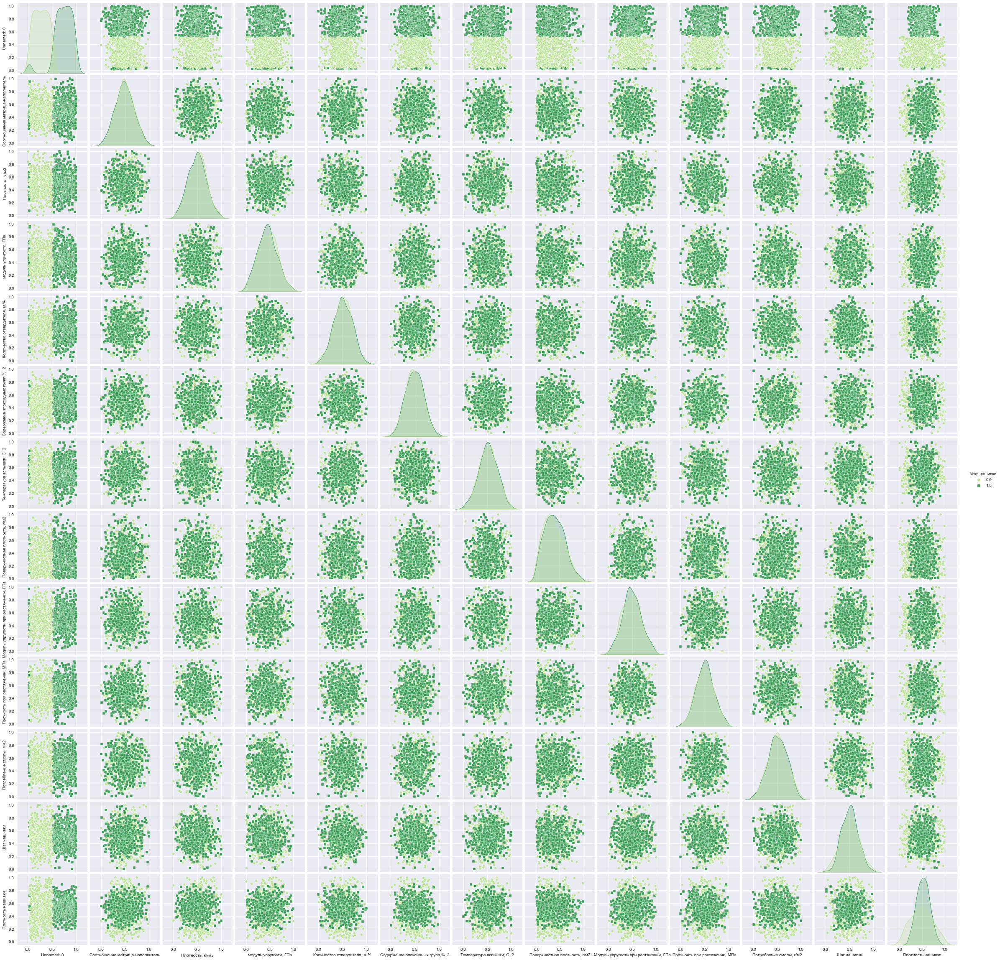

In [57]:
sns.pairplot(df_minmax_n, hue = 'Угол нашивки', markers = ["o", "s"], diag_kind = 'auto', palette = 'YlGn')

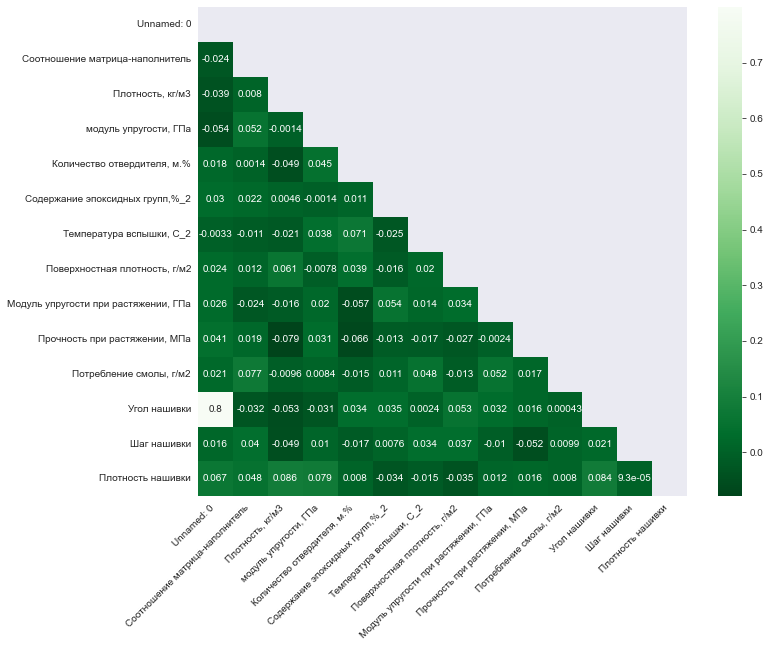

In [58]:
mask = np.triu(df_minmax_n.corr())
f, ax = plt.subplots(figsize = (11, 9))
sns.heatmap(df_minmax_n.corr(), mask = mask, annot = True, square = True, cmap = 'Greens_r')
plt.xticks(rotation = 45, ha = 'right')
plt.show()

Нормализуем данные с помощью Normalizer()

In [59]:
normalizer = Normalizer()
res = normalizer.fit_transform(df)
df_norm_n = pd.DataFrame(res, columns = df.columns)
df_norm_n

,Unnamed: 0,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
0,0.000269,0.000499,0.545436,0.198490,0.013434,0.006381,0.076473,0.056424,0.018808,0.806064,0.059111,0.000000,0.001075,0.016121
1,0.000805,0.000499,0.545011,0.198335,0.034634,0.005705,0.080543,0.056380,0.018793,0.805435,0.059065,0.000000,0.001342,0.012618
2,0.001074,0.000744,0.544829,0.202097,0.030022,0.005976,0.076388,0.056362,0.018787,0.805166,0.059046,0.000000,0.001342,0.015298
3,0.001348,0.000746,0.539270,0.201687,0.030161,0.006004,0.076742,0.056623,0.018874,0.808905,0.059320,0.000000,0.001348,0.016178
4,0.001633,0.000699,0.519918,0.219672,0.030449,0.006062,0.077475,0.057164,0.019055,0.816626,0.059886,0.000000,0.001361,0.019055
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
917,0.299413,0.000668,0.574145,0.268488,0.025586,0.005919,0.095522,0.061529,0.021497,0.702147,0.036767,0.000294,0.002670,0.013829
918,0.303916,0.001027,0.611437,0.132641,0.043539,0.005846,0.075820,0.104584,0.021749,0.703985,0.035113,0.000298,0.003151,0.016031
919,0.284168,0.000914,0.549496,0.116129,0.030794,0.006674,0.069210,0.206201,0.020821,0.741876,0.065918,0.000279,0.001159,0.018841
920,0.311960,0.001132,0.631497,0.226553,0.043203,0.005881,0.084263,0.195996,0.022623,0.632999,0.060231,0.000306,0.001929,0.017801


<AxesSubplot:ylabel='Density'>

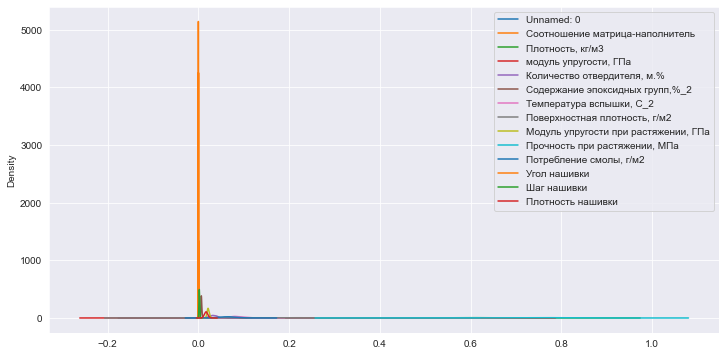

In [60]:
fig, ax = plt.subplots(figsize = (12, 6))
df_norm_n.plot(kind = 'kde', ax = ax)

Сравним с данными до нормализации

In [61]:
df.head(10)

,Unnamed: 0,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
1,1,1.857143,2030.0,738.736842,50.00,23.750000,284.615385,210.0,70.0,3000.0,220.0,0,4.0,60.0
3,3,1.857143,2030.0,738.736842,129.00,21.250000,300.000000,210.0,70.0,3000.0,220.0,0,5.0,47.0
4,4,2.771331,2030.0,753.000000,111.86,22.267857,284.615385,210.0,70.0,3000.0,220.0,0,5.0,57.0
5,5,2.767918,2000.0,748.000000,111.86,22.267857,284.615385,210.0,70.0,3000.0,220.0,0,5.0,60.0
6,6,2.569620,1910.0,807.000000,111.86,22.267857,284.615385,210.0,70.0,3000.0,220.0,0,5.0,70.0
7,7,2.561475,1900.0,535.000000,111.86,22.267857,284.615385,380.0,75.0,1800.0,120.0,0,7.0,47.0
8,8,3.557018,1930.0,889.000000,129.00,21.250000,300.000000,380.0,75.0,1800.0,120.0,0,7.0,57.0
9,9,3.532338,2100.0,1421.000000,129.00,21.250000,300.000000,1010.0,78.0,2000.0,300.0,0,7.0,60.0
10,10,2.919678,2160.0,933.000000,129.00,21.250000,300.000000,1010.0,78.0,2000.0,300.0,0,7.0,70.0
11,11,2.877358,1990.0,1628.000000,129.00,21.250000,300.000000,1010.0,78.0,2000.0,300.0,0,9.0,47.0


Проверяем перевод данных из нормализованных в исходные

In [62]:
col = df_minmax_n.columns
result_reverse = scaler.inverse_transform(df_minmax_n)
initial_data = pd.DataFrame(result_reverse, columns = col)
initial_data.head(10)

,Unnamed: 0,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
0,1.0,1.857143,2030.0,738.736842,50.00,23.750000,284.615385,210.0,70.0,3000.0,220.0,0.0,4.0,60.0
1,3.0,1.857143,2030.0,738.736842,129.00,21.250000,300.000000,210.0,70.0,3000.0,220.0,0.0,5.0,47.0
2,4.0,2.771331,2030.0,753.000000,111.86,22.267857,284.615385,210.0,70.0,3000.0,220.0,0.0,5.0,57.0
3,5.0,2.767918,2000.0,748.000000,111.86,22.267857,284.615385,210.0,70.0,3000.0,220.0,0.0,5.0,60.0
4,6.0,2.569620,1910.0,807.000000,111.86,22.267857,284.615385,210.0,70.0,3000.0,220.0,0.0,5.0,70.0
5,7.0,2.561475,1900.0,535.000000,111.86,22.267857,284.615385,380.0,75.0,1800.0,120.0,0.0,7.0,47.0
6,8.0,3.557018,1930.0,889.000000,129.00,21.250000,300.000000,380.0,75.0,1800.0,120.0,0.0,7.0,57.0
7,9.0,3.532338,2100.0,1421.000000,129.00,21.250000,300.000000,1010.0,78.0,2000.0,300.0,0.0,7.0,60.0
8,10.0,2.919678,2160.0,933.000000,129.00,21.250000,300.000000,1010.0,78.0,2000.0,300.0,0.0,7.0,70.0
9,11.0,2.877358,1990.0,1628.000000,129.00,21.250000,300.000000,1010.0,78.0,2000.0,300.0,0.0,9.0,47.0


Рассмотрим несколько вариантов корреляции между параметрами после нормализации (первый вариант)

In [63]:
df_norm_n[df_norm_n.columns].corr()

,Unnamed: 0,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
Unnamed: 0,1.000000,-0.033796,0.002529,-0.090898,0.019401,0.033753,0.004366,-0.015283,0.022874,-0.217113,0.017142,0.796429,0.028901,0.077044
Соотношение матрица-наполнитель,-0.033796,1.000000,0.280622,0.036782,0.134748,0.219845,0.178033,0.025394,0.261578,-0.245254,0.157467,-0.049659,0.135475,0.171491
"Плотность, кг/м3",0.002529,0.280622,1.000000,-0.034356,0.383457,0.649813,0.556780,0.070742,0.870827,-0.819223,0.308161,-0.034143,0.283752,0.426895
"модуль упругости, ГПа",-0.090898,0.036782,-0.034356,1.000000,0.052280,-0.023756,0.009051,-0.022351,-0.019829,-0.358647,-0.007192,-0.063944,0.004988,0.047297
"Количество отвердителя, м.%",0.019401,0.134748,0.383457,0.052280,1.000000,0.297736,0.304911,0.068762,0.370032,-0.372063,0.137245,0.017838,0.117068,0.193626
"Содержание эпоксидных групп,%_2",0.033753,0.219845,0.649813,-0.023756,0.297736,1.000000,0.395309,0.027208,0.651618,-0.538988,0.237992,0.016582,0.229350,0.263468
"Температура вспышки, С_2",0.004366,0.178033,0.556780,0.009051,0.304911,0.395309,1.000000,0.039908,0.555511,-0.496694,0.240827,-0.009314,0.210315,0.246554
"Поверхностная плотность, г/м2",-0.015283,0.025394,0.070742,-0.022351,0.068762,0.027208,0.039908,1.000000,0.057970,-0.306366,0.005905,0.025436,0.066920,-0.018802
"Модуль упругости при растяжении, ГПа",0.022874,0.261578,0.870827,-0.019829,0.370032,0.651618,0.555511,0.057970,1.000000,-0.728166,0.323669,-0.001700,0.294400,0.397528
"Прочность при растяжении, МПа",-0.217113,-0.245254,-0.819223,-0.358647,-0.372063,-0.538988,-0.496694,-0.306366,-0.728166,1.000000,-0.273597,-0.169963,-0.274958,-0.376271


Рассмотрим второй вариант корреляции между параметрами после нормализации (второй вариант)

In [64]:
df_minmax_n[df_minmax_n.columns].corr()

,Unnamed: 0,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
Unnamed: 0,1.000000,-0.024374,-0.039229,-0.054259,0.017996,0.029789,-0.003255,0.024305,0.025623,0.041208,0.021012,0.799537,0.016178,0.067496
Соотношение матрица-наполнитель,-0.024374,1.000000,0.007996,0.051643,0.001353,0.021982,-0.010565,0.011910,-0.024316,0.019141,0.076857,-0.032144,0.039924,0.047835
"Плотность, кг/м3",-0.039229,0.007996,1.000000,-0.001416,-0.048938,0.004568,-0.021256,0.061496,-0.015597,-0.079188,-0.009609,-0.052993,-0.048648,0.086460
"модуль упругости, ГПа",-0.054259,0.051643,-0.001416,1.000000,0.044550,-0.001442,0.037622,-0.007805,0.020063,0.031041,0.008368,-0.031490,0.010238,0.078810
"Количество отвердителя, м.%",0.017996,0.001353,-0.048938,0.044550,1.000000,0.011429,0.070623,0.038762,-0.057026,-0.065711,-0.014827,0.034103,-0.017394,0.007981
"Содержание эпоксидных групп,%_2",0.029789,0.021982,0.004568,-0.001442,0.011429,1.000000,-0.025315,-0.015844,0.053887,-0.013099,0.010808,0.034520,0.007571,-0.034481
"Температура вспышки, С_2",-0.003255,-0.010565,-0.021256,0.037622,0.070623,-0.025315,1.000000,0.020307,0.014168,-0.017263,0.048142,0.002371,0.034395,-0.015014
"Поверхностная плотность, г/м2",0.024305,0.011910,0.061496,-0.007805,0.038762,-0.015844,0.020307,1.000000,0.033526,-0.027320,-0.012606,0.053180,0.036931,-0.034989
"Модуль упругости при растяжении, ГПа",0.025623,-0.024316,-0.015597,0.020063,-0.057026,0.053887,0.014168,0.033526,1.000000,-0.002393,0.051676,0.031910,-0.010193,0.012488
"Прочность при растяжении, МПа",0.041208,0.019141,-0.079188,0.031041,-0.065711,-0.013099,-0.017263,-0.027320,-0.002393,1.000000,0.016753,0.016144,-0.051580,0.016311


In [65]:
df_minmax_n

,Unnamed: 0,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
0,0.000000,0.274768,0.651097,0.452951,0.079153,0.607435,0.509164,0.162230,0.272962,0.727777,0.514688,0.0,0.289334,0.546433
1,0.001959,0.274768,0.651097,0.452951,0.630983,0.418887,0.583596,0.162230,0.272962,0.727777,0.514688,0.0,0.362355,0.319758
2,0.002938,0.466552,0.651097,0.461725,0.511257,0.495653,0.509164,0.162230,0.272962,0.727777,0.514688,0.0,0.362355,0.494123
3,0.003918,0.465836,0.571539,0.458649,0.511257,0.495653,0.509164,0.162230,0.272962,0.727777,0.514688,0.0,0.362355,0.546433
4,0.004897,0.424236,0.332865,0.494944,0.511257,0.495653,0.509164,0.162230,0.272962,0.727777,0.514688,0.0,0.362355,0.720799
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
917,0.996082,0.361662,0.444480,0.560064,0.337550,0.333908,0.703458,0.161609,0.473553,0.472912,0.183151,1.0,0.660014,0.320103
918,0.997062,0.607674,0.704373,0.272088,0.749605,0.294428,0.362087,0.271207,0.462512,0.461722,0.157752,1.0,0.768759,0.437468
919,0.998041,0.573391,0.498274,0.254927,0.501991,0.623085,0.334063,0.572959,0.580201,0.587558,0.572648,1.0,0.301102,0.679468
920,0.999021,0.662497,0.748688,0.454635,0.717585,0.267818,0.466417,0.496511,0.535317,0.341643,0.434855,1.0,0.458245,0.516112


In [66]:
df_norm_n

,Unnamed: 0,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
0,0.000269,0.000499,0.545436,0.198490,0.013434,0.006381,0.076473,0.056424,0.018808,0.806064,0.059111,0.000000,0.001075,0.016121
1,0.000805,0.000499,0.545011,0.198335,0.034634,0.005705,0.080543,0.056380,0.018793,0.805435,0.059065,0.000000,0.001342,0.012618
2,0.001074,0.000744,0.544829,0.202097,0.030022,0.005976,0.076388,0.056362,0.018787,0.805166,0.059046,0.000000,0.001342,0.015298
3,0.001348,0.000746,0.539270,0.201687,0.030161,0.006004,0.076742,0.056623,0.018874,0.808905,0.059320,0.000000,0.001348,0.016178
4,0.001633,0.000699,0.519918,0.219672,0.030449,0.006062,0.077475,0.057164,0.019055,0.816626,0.059886,0.000000,0.001361,0.019055
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
917,0.299413,0.000668,0.574145,0.268488,0.025586,0.005919,0.095522,0.061529,0.021497,0.702147,0.036767,0.000294,0.002670,0.013829
918,0.303916,0.001027,0.611437,0.132641,0.043539,0.005846,0.075820,0.104584,0.021749,0.703985,0.035113,0.000298,0.003151,0.016031
919,0.284168,0.000914,0.549496,0.116129,0.030794,0.006674,0.069210,0.206201,0.020821,0.741876,0.065918,0.000279,0.001159,0.018841
920,0.311960,0.001132,0.631497,0.226553,0.043203,0.005881,0.084263,0.195996,0.022623,0.632999,0.060231,0.000306,0.001929,0.017801


Построим на "ящики с усами"
Выводим "ящики"

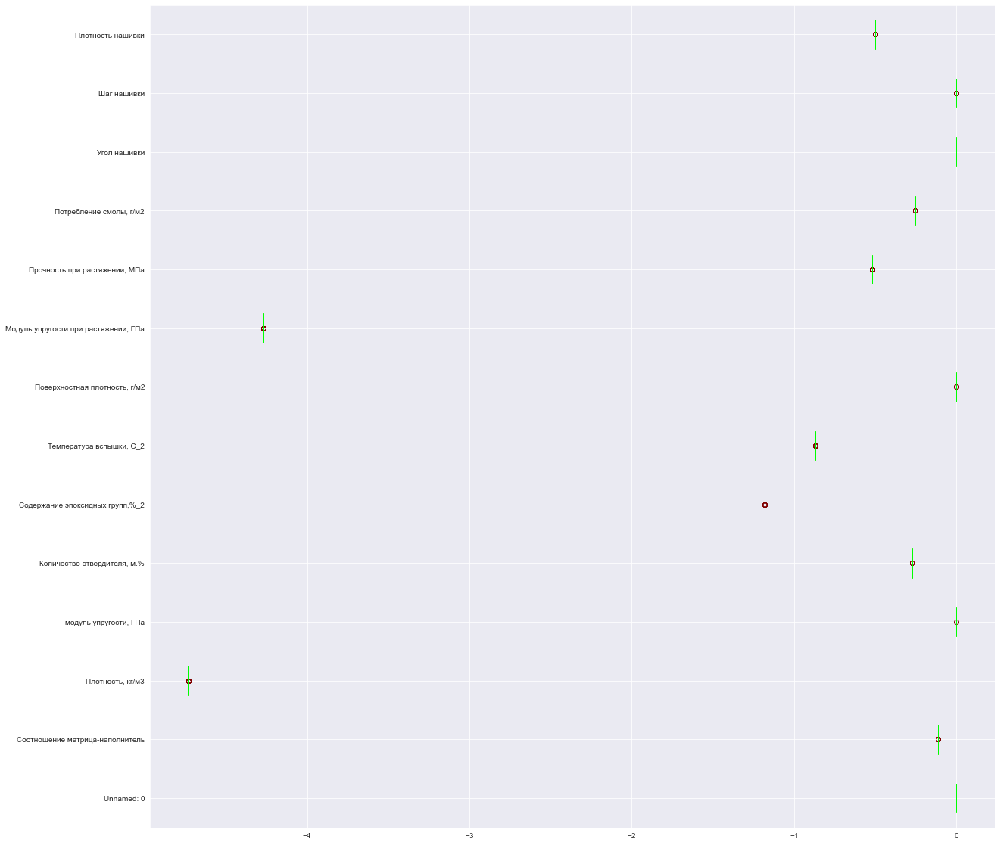

In [67]:
scaler = MinMaxScaler()
scaler.fit(df)
plt.figure(figsize=(20, 20))
plt.boxplot(pd.DataFrame(scaler.transform(df_norm_n)), labels = df_norm_n.columns, patch_artist = True, meanline = True, vert = False, boxprops = dict(facecolor = 'g', color = 'y'),medianprops = dict(color = 'lime'), whiskerprops = dict(color = "g"), capprops = dict(color="black"), flierprops = dict(color = "y", markeredgecolor = "maroon"))
plt.show()

Попытаемся посмотреть на "ящики с усами"
Выводим "ящики"

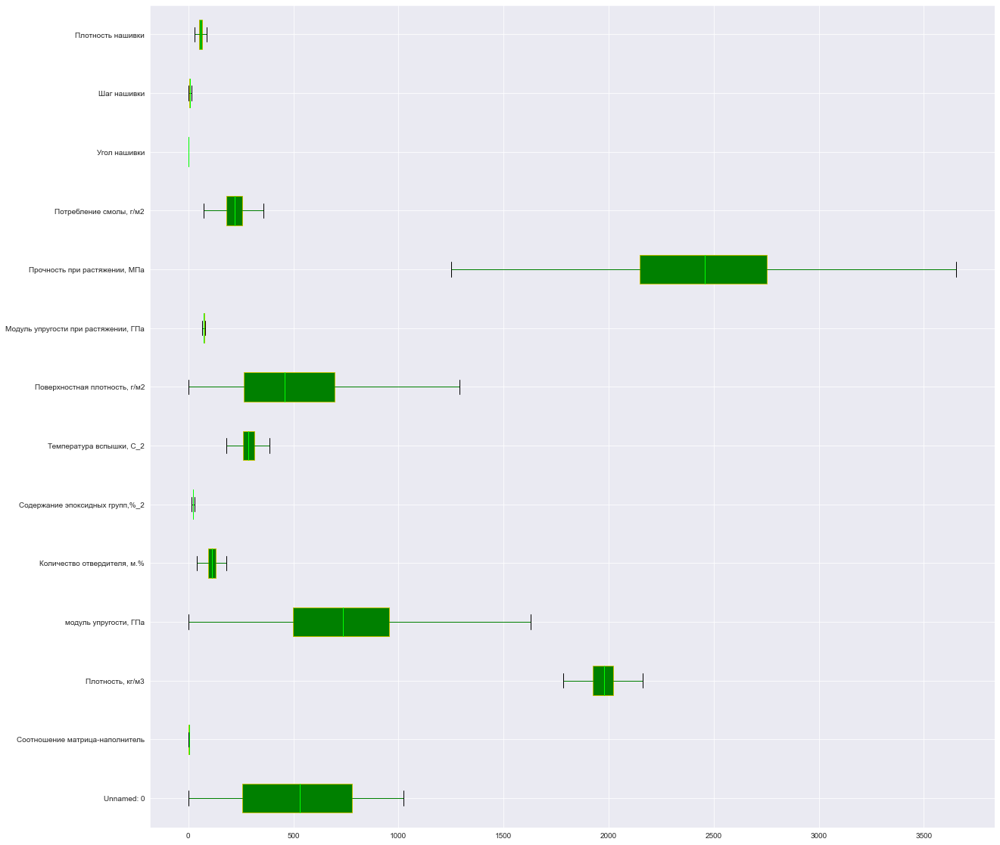

In [68]:
scaler = MinMaxScaler()
scaler.fit(df_minmax_n)
plt.figure(figsize = (20, 20))
plt.boxplot(pd.DataFrame(scaler.transform(df)), labels = df_minmax_n.columns, patch_artist = True, meanline = True, vert = False, boxprops = dict(facecolor = 'g', color = 'y'),medianprops = dict(color = 'lime'), whiskerprops = dict(color = "g"), capprops = dict(color = "black"), flierprops = dict(color = "y", markeredgecolor = "maroon"))
plt.show()

Визуализация графиков показывает, что нормализация при помощи "Normalizer" дает нам большое количество выбросов

# Стандартизируем данные.

In [69]:
X1 = df_minmax_n.copy()
X2 = df_norm_n.copy()

In [70]:
df_std_X1 = preprocessing.StandardScaler().fit(X1)
df_standart_X1 = df_std_X1.transform(X1)
df_standart_1 = pd.DataFrame(df_standart_X1)

<AxesSubplot:ylabel='Density'>

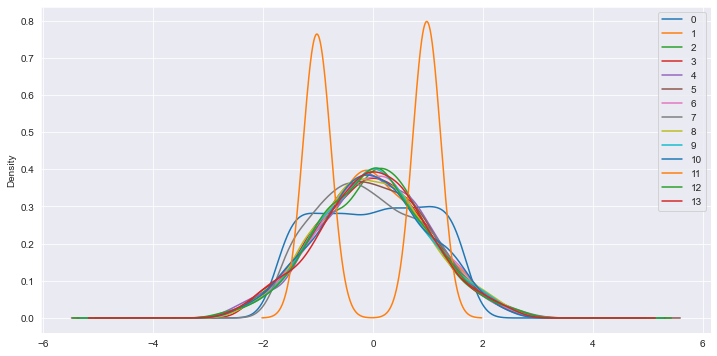

In [71]:
fig, ax = plt.subplots(figsize = (12, 6))
df_standart_1.plot(kind = 'kde', ax = ax)

In [72]:
df_standart_1

,0,1,2,3,4,5,6,7,8,9,10,11,12,13
0,-1.739099,-1.196467,0.787037,0.007992,-2.286425,0.647585,-0.039740,-0.971971,-1.092335,1.187925,0.034181,-1.021932,-1.166792,0.219240
1,-1.732380,-1.196467,0.787037,0.007992,0.668092,-0.397291,0.350738,-0.971971,-1.092335,1.187925,0.034181,-1.021932,-0.768833,-0.950227
2,-1.729020,-0.175012,0.787037,0.051553,0.027074,0.028123,-0.039740,-0.971971,-1.092335,1.187925,0.034181,-1.021932,-0.768833,-0.050637
3,-1.725661,-0.178825,0.364514,0.036283,0.027074,0.028123,-0.039740,-0.971971,-1.092335,1.187925,0.034181,-1.021932,-0.768833,0.219240
4,-1.722301,-0.400390,-0.903054,0.216474,0.027074,0.028123,-0.039740,-0.971971,-1.092335,1.187925,0.034181,-1.021932,-0.768833,1.118831
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
917,1.677664,-0.733662,-0.310284,0.539767,-0.902956,-0.868217,0.979545,-0.974830,-0.070267,-0.163679,-1.629244,0.978538,0.853400,-0.948449
918,1.681023,0.576611,1.069974,-0.889924,1.303201,-1.087006,-0.811326,-0.470122,-0.126524,-0.223019,-1.756683,0.978538,1.446055,-0.342933
919,1.684383,0.394018,-0.024589,-0.975122,-0.022536,0.734311,-0.958342,0.919470,0.473140,0.444312,0.324984,0.978538,-1.102660,0.905599
920,1.687742,0.868603,1.305328,0.016356,1.131763,-1.234469,-0.263996,0.567419,0.244441,-0.859827,-0.366368,0.978538,-0.246233,0.062808


In [73]:
df_std_X2 = preprocessing.StandardScaler().fit(X2)
df_standart_X2 = df_std_X2.transform(X2)
df_standart_2 = pd.DataFrame(df_standart_X2)

<AxesSubplot:ylabel='Density'>

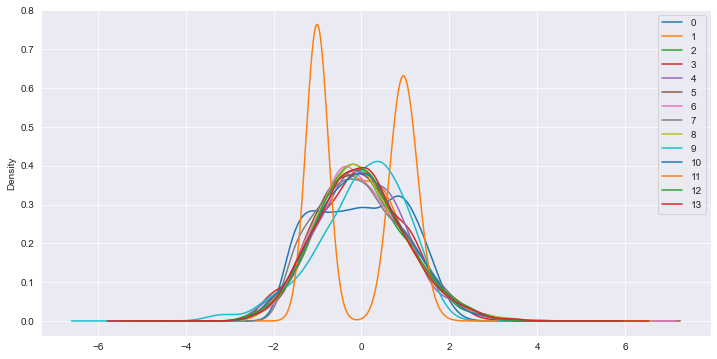

In [74]:
fig, ax = plt.subplots(figsize = (12, 6))
df_standart_2.plot(kind = 'kde', ax=ax)

In [75]:
df_standart_2

,0,1,2,3,4,5,6,7,8,9,10,11,12,13
0,-1.739385,-1.324290,-0.673310,-0.192709,-2.238400,-0.229669,-0.592779,-1.043223,-1.252979,1.233256,-0.315993,-1.011359,-1.249682,-0.268579
1,-1.733271,-1.325677,-0.680131,-0.194349,0.172936,-0.913623,-0.315598,-1.043756,-1.259092,1.224275,-0.318535,-1.011359,-0.912495,-1.212890
2,-1.730217,-0.452381,-0.683041,-0.154526,-0.351629,-0.639223,-0.598576,-1.043983,-1.261699,1.220444,-0.319619,-1.011359,-0.913058,-0.490481
3,-1.727089,-0.443357,-0.772113,-0.158863,-0.335771,-0.611150,-0.574422,-1.040815,-1.225372,1.273817,-0.304515,-1.011359,-0.905207,-0.253258
4,-1.723842,-0.610240,-1.082192,0.031521,-0.303027,-0.553184,-0.524549,-1.034272,-1.150363,1.384023,-0.273329,-1.011359,-0.888996,0.522208
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
917,1.667873,-0.722175,-0.213300,0.548260,-0.856201,-0.697708,0.704321,-0.981427,-0.133222,-0.250095,-1.546787,0.967697,0.759512,-0.886443
918,1.719164,0.556940,0.384241,-0.889752,1.185882,-0.771553,-0.637253,-0.460225,-0.028640,-0.223856,-1.637904,0.995491,1.366327,-0.292881
919,1.494237,0.153711,-0.608268,-1.064542,-0.263789,0.066835,-1.087322,0.769892,-0.414989,0.317007,0.058926,0.863251,-1.143186,0.464726
920,1.810786,0.930807,0.705665,0.104358,1.147689,-0.735985,-0.062347,0.646362,0.335566,-1.237139,-0.254341,1.044573,-0.173505,0.184334


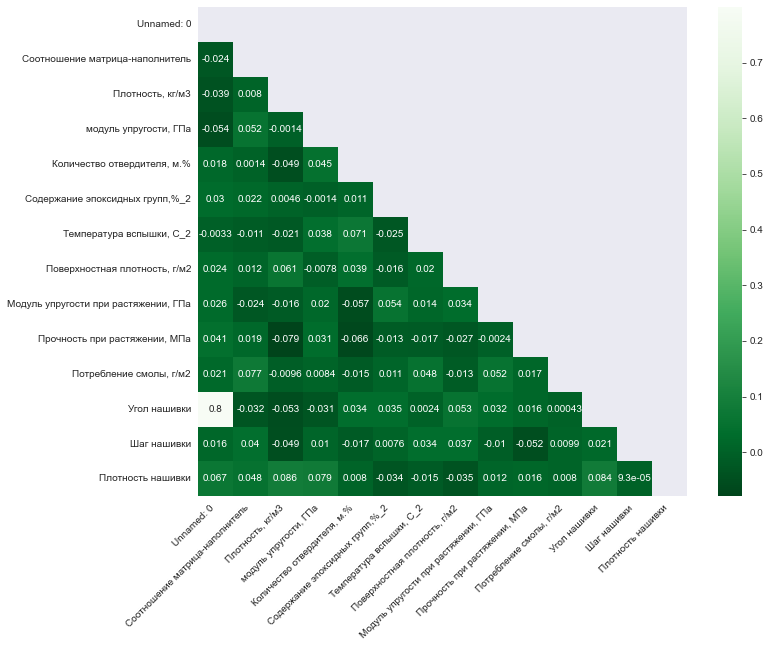

In [76]:
mask = np.triu(X1.corr())
f, ax = plt.subplots(figsize=(11, 9))
sns.heatmap(X1.corr(), mask=mask, annot=True, square=True, cmap='Greens_r')
plt.xticks(rotation=45, ha='right')
plt.show()

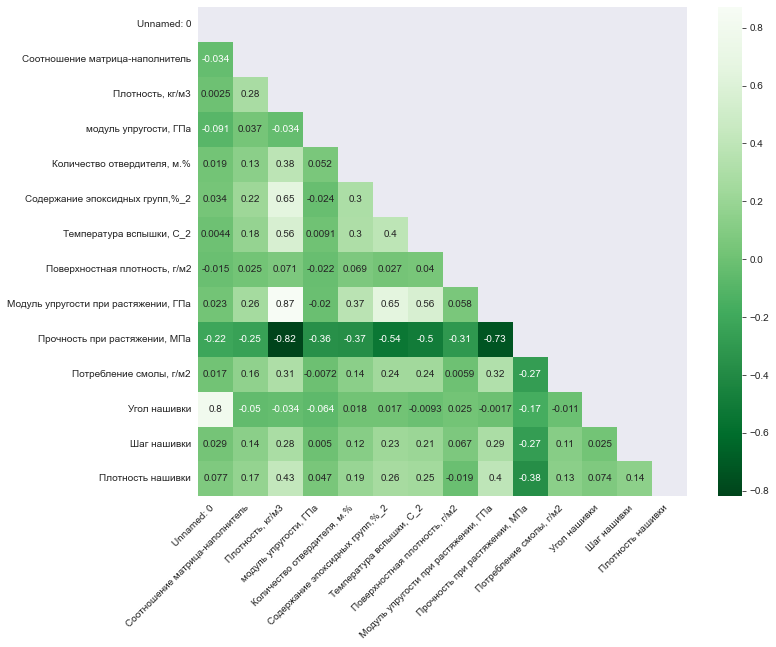

In [77]:
mask = np.triu(X2.corr())
f, ax = plt.subplots(figsize=(11, 9))
sns.heatmap(X2.corr(), mask=mask, annot=True, square=True, cmap='Greens_r')
plt.xticks(rotation=45, ha='right')
plt.show()

In [78]:
df_norm_n.describe()

,Unnamed: 0,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
count,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000
mean,0.152980,0.000871,0.587457,0.216695,0.033113,0.006608,0.085178,0.142602,0.021817,0.719668,0.064848,0.000150,0.002067,0.017118
std,0.087844,0.000281,0.062443,0.094520,0.008796,0.000989,0.014694,0.082652,0.002403,0.070093,0.018164,0.000149,0.000794,0.003711
min,0.000269,0.000161,0.443150,0.000701,0.011337,0.004098,0.049217,0.000229,0.015974,0.463101,0.021460,0.000000,0.000011,0.007138
25%,0.076546,0.000674,0.543122,0.148451,0.027150,0.005896,0.075030,0.078853,0.020113,0.678625,0.051869,0.000000,0.001521,0.014596
50%,0.153931,0.000858,0.583739,0.217452,0.032877,0.006555,0.083983,0.137999,0.021633,0.727476,0.064677,0.000238,0.002036,0.017058
75%,0.227370,0.001049,0.627466,0.283838,0.039028,0.007243,0.095337,0.201108,0.023387,0.771457,0.077095,0.000293,0.002567,0.019439
max,0.354387,0.001803,0.797127,0.525061,0.062843,0.010553,0.143094,0.414069,0.030433,0.874715,0.122192,0.000407,0.004517,0.029980


In [79]:
df_minmax_n.describe()

,Unnamed: 0,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
count,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000,922.000000
mean,0.506996,0.499412,0.502904,0.451341,0.506200,0.490578,0.516739,0.373295,0.487343,0.503776,0.507876,0.510846,0.503426,0.503938
std,0.291686,0.187858,0.188395,0.201534,0.186876,0.180548,0.190721,0.217269,0.196366,0.188668,0.199418,0.500154,0.183587,0.193933
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.251959,0.371909,0.368184,0.305188,0.378514,0.366571,0.386228,0.204335,0.353512,0.373447,0.374647,0.000000,0.372844,0.376869
50%,0.517140,0.495189,0.511396,0.451377,0.506382,0.488852,0.516931,0.354161,0.483718,0.501481,0.510143,1.000000,0.506414,0.504310
75%,0.760774,0.629774,0.624719,0.587193,0.638735,0.623046,0.646553,0.538397,0.617568,0.624299,0.642511,1.000000,0.626112,0.630842
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


# Разработка и обучение нескольких моделей для прогноза прочности при растяжении.

'''Данные в нашем итоговом датасете в основном непрерывные и на ум приходит сразу решение данной задачи с использованием регрессионных моделей.
Но попарные графики рассеивания точек и тепловая карта не дают нам реальной взаимосвязи и возможности прямого прогнозирования, 
поэтому будем использовать и категориальные подходы к прогнозированию (например, попробуем метод ближайших соседей) 
или обучение со скрытыми слоями, чтобы выявить дополнительные взаимосвязи.
Задача ВКР на этом этапе звучит так: "При построении моделей провести поиск гиперпараметров модели с помощью поиска по сетке с перекрестной проверкой, количество блоков равно 10.'''


Сформируем выборки и посмотрим, что получилось.

Прогнозируем прочность при растяжении

После всех подготовительных работ переходим к процессу создания, обучения моделей.
Мы будем использовать в Python библиотеку Scikit-Learn.
В качестве базового уровня предскажем медианное значение цели на обучающем наборе для всех примеров в тестовом наборе.
В качестве метрики возьмём среднюю абсолютную ошибку (mae) в прогнозах.
Для обучения используем 70 % данных, а для тестирования — 30 %.

разбиваем на тестовую, тренировочную выборки, выделяя предикторы и целевые переменные

In [80]:
x_train_1, x_test_1, y_train_1, y_test_1 = train_test_split(
 df_norm_n.loc[:, df_norm_n.columns != 'Прочность при растяжении, МПа'],
 df[['Прочность при растяжении, МПа']],
 test_size = 0.3,
 random_state = 42)

Проверка правильности разбивки

In [81]:
df_norm_n.shape[0] - x_train_1.shape[0] - x_test_1.shape[0]

0

In [82]:
x_train_1.head()

,Unnamed: 0,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Потребление смолы, г/м2",Угол нашивки,Шаг нашивки,Плотность нашивки
481,0.158395,0.000521,0.581630,0.130481,0.020732,0.006175,0.070548,0.183734,0.019964,0.072115,0.000287,0.002256,0.015366
650,0.220659,0.000420,0.602084,0.226778,0.026580,0.007165,0.073716,0.079342,0.024225,0.055438,0.000300,0.001317,0.017858
483,0.161219,0.000572,0.577775,0.168288,0.042834,0.006981,0.095287,0.131070,0.020920,0.040945,0.000291,0.002220,0.018682
355,0.108647,0.000906,0.542665,0.304318,0.024324,0.006571,0.070070,0.158971,0.018417,0.049851,0.000000,0.001764,0.012466
850,0.292133,0.000548,0.569733,0.252476,0.032675,0.007191,0.085674,0.091427,0.022495,0.082570,0.000308,0.002645,0.016430


In [83]:
y_train_1

,"Прочность при растяжении, МПа"
552,2641.571967
735,2404.068921
554,2619.854215
403,2793.783901
948,2298.985700
...,...
120,1994.674603
306,2419.732206
959,2758.414767
497,2347.135204


In [84]:
y_test_1

,"Прочность при растяжении, МПа"
360,2167.533030
427,2705.819718
611,2952.839631
336,2305.241225
604,1399.118555
...,...
479,3305.286922
149,2085.866383
561,2461.609016
632,2616.114331


In [85]:
y_train_1.shape

(645, 1)

Функция для сравнения результатов предсказаний с моделью, выдающей среднее значение по тестовой выборке

In [86]:
def mean_model(y_test_1):
    return [np.mean(y_test_1) for _ in range(len(y_test_1))]
y_1_pred_mean = mean_model(y_test_1)

Проверка различных моделей при стандартных параметрах.
Метод опорных векторов - 1

In [87]:
svr = make_pipeline(StandardScaler(), SVR(kernel = 'rbf', C = 500.0, epsilon = 1.0))

обучаем модель

вычисляем коэффициент детерминации

In [88]:
svr.fit(x_train_1, np.ravel(y_train_1))
y_pred_svr=svr.predict(x_test_1)
mae_svr = mean_absolute_error(y_pred_svr, y_test_1)
mse_svr_elast = mean_squared_error(y_test_1,y_pred_svr)
print('Support Vector Regression Results Train:')
print("Test score: {:.2f}".format(svr.score(x_train_1, y_train_1))) # Скор для тренировочной выборки
print('Support Vector Regression Results:')
print('SVR_MAE:', round(mean_absolute_error(y_test_1, y_pred_svr)))
print('SVR_MAPE: {:.2f}'.format(mean_absolute_percentage_error(y_test_1, y_pred_svr)))
print('SVR_MSE: {:.2f}'.format(mse_svr_elast))
print("SVR_RMSE: {:.2f}".format (np.sqrt(mse_svr_elast)))
print("Test score: {:.2f}".format(svr.score(x_test_1, y_test_1))) # Скор для тестовой выборки

Support Vector Regression Results Train:
Test score: 0.99
Support Vector Regression Results:
SVR_MAE: 76
SVR_MAPE: 0.03
SVR_MSE: 11159.19
SVR_RMSE: 105.64
Test score: 0.95


Результаты модели, выдающей среднее значение

In [89]:
mse_lin_elast_mean = mean_squared_error(y_test_1, y_1_pred_mean)
print("MAE for mean target: ", mean_absolute_error(y_test_1, y_1_pred_mean))
print("MSE for mean target: ", mse_lin_elast_mean)
print("RMSE for mean target: ", np.sqrt(mse_lin_elast_mean))

MAE for mean target:  368.96801863398946
MSE for mean target:  214046.3755454378
RMSE for mean target:  462.65146227526157


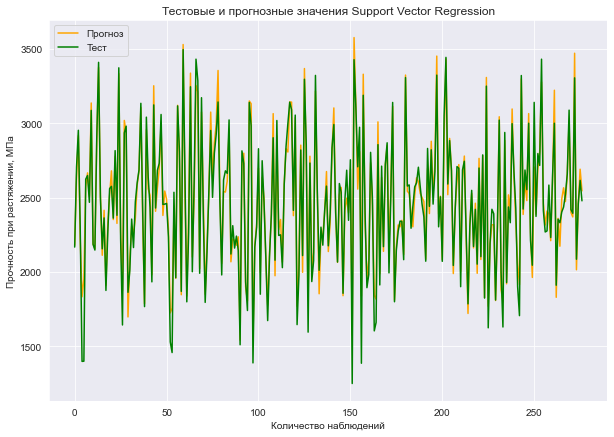

In [90]:
plt.figure(figsize = (10, 7))
plt.title("Тестовые и прогнозные значения Support Vector Regression")
plt.plot(y_pred_svr, label = "Прогноз", color = "orange")
plt.plot(y_test_1.values, label = "Тест", color = "green")
plt.xlabel("Количество наблюдений")
plt.ylabel("Прочность при растяжении, МПа")
plt.legend()
plt.grid(True);

Метод случайного леса - Random Forest Regressor - 2

построение модели и вузуализация метода случайный лес

In [91]:
rfr = RandomForestRegressor(n_estimators=15,max_depth=7, random_state=33)
rfr.fit(x_train_1, y_train_1.values)
y_pred_forest = rfr.predict(x_test_1)
mae_rfr = mean_absolute_error(y_pred_forest, y_test_1)
mse_rfr_elast = mean_squared_error(y_test_1,y_pred_forest)
print('Random Forest Regressor Results Train:')
print("Test score: {:.2f}".format(rfr.score(x_train_1, y_train_1))) # Скор для тренировочной выборки
print('Random Forest Regressor Results:')
print('RF_MAE: ', round(mean_absolute_error(y_test_1, y_pred_forest)))
print('RF_MAPE: {:.2f}'.format(mean_absolute_percentage_error(y_test_1, y_pred_forest)))
print('RF_MSE: {:.2f}'.format(mse_rfr_elast))
print("RF_RMSE: {:.2f}".format (np.sqrt(mse_rfr_elast)))
print("Test score: {:.2f}".format(rfr.score(x_test_1, y_test_1))) # Скор для тестовой выборки

Random Forest Regressor Results Train:
Test score: 0.98
Random Forest Regressor Results:
RF_MAE:  82
RF_MAPE: 0.03
RF_MSE: 10708.90
RF_RMSE: 103.48
Test score: 0.95


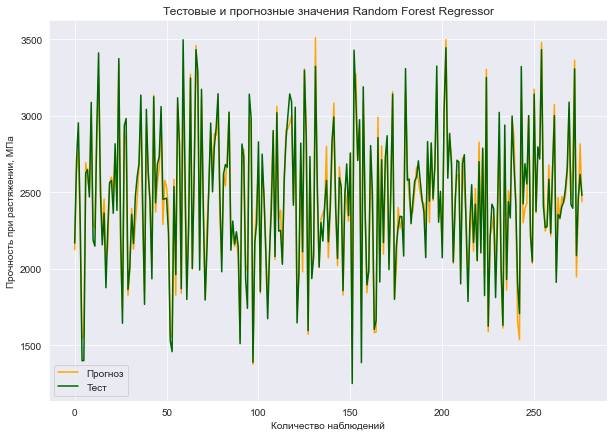

In [92]:
plt.figure(figsize = (10, 7))
plt.title("Тестовые и прогнозные значения Random Forest Regressor")
plt.plot(y_pred_forest, label = "Прогноз", color = "orange")
plt.plot(y_test_1.values, label = "Тест", color = 'darkgreen')
plt.xlabel("Количество наблюдений")
plt.ylabel("Прочность при растяжении, МПа")
plt.legend()
plt.grid(True);

Метод линейной регрессии - Linear Regression - 3

построение модели и вузуализация Линейной регрессии

In [93]:
lr = LinearRegression()
lr.fit(x_train_1, y_train_1)
y_pred_lr = lr.predict(x_test_1)
mae_lr = mean_absolute_error(y_pred_lr, y_test_1)
mse_lin_elast = mean_squared_error(y_test_1, y_pred_lr)
print('Linear Regression Results Train:') # Скор для тренировочной выборки
print("Test score: {:.2f}".format(lr.score(x_train_1, y_train_1)))
print('Linear Regression Results:') 
print('lr_MAE: ', round(mean_absolute_error(y_test_1, y_pred_lr)))
print('lr_MAPE: {:.2f}'.format(mean_absolute_percentage_error(y_test_1, y_pred_lr)))
print('lr_MSE: {:.2f}'.format(mse_lin_elast))
print("lr_RMSE: {:.2f}".format (np.sqrt(mse_lin_elast)))
print("Test score: {:.2f}".format(lr.score(x_test_1, y_test_1))) # Скор для тестовой выборки

Linear Regression Results Train:
Test score: 0.97
Linear Regression Results:
lr_MAE:  64
lr_MAPE: 0.03
lr_MSE: 6491.80
lr_RMSE: 80.57
Test score: 0.97


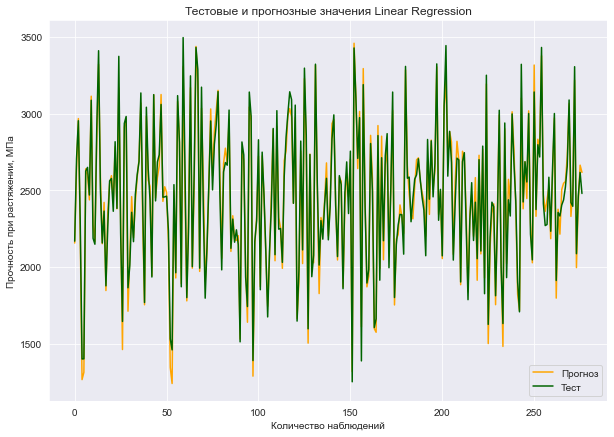

In [94]:
plt.figure(figsize = (10, 7))
plt.title("Тестовые и прогнозные значения Linear Regression")
plt.plot(y_pred_lr, label="Прогноз", color = 'orange')
plt.plot(y_test_1.values, label = "Тест", color = 'darkgreen')
plt.xlabel("Количество наблюдений")
plt.ylabel("Прочность при растяжении, МПа")
plt.legend()
plt.grid(True);

Линейная регрессия с задачей справилась в 97 % случаев.

Визуализация гистограммы распределения ошибки

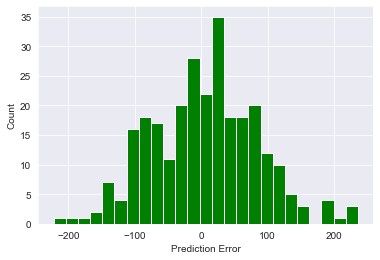

In [95]:
error = y_test_1 - y_pred_lr
plt.hist(error, bins = 25, color = "g")
plt.xlabel('Prediction Error')
_ = plt.ylabel('Count')

Метода градиентного бустинга - Gradient Boosting Regressor - 4

In [96]:
gbr = make_pipeline(StandardScaler(), GradientBoostingRegressor())
gbr.fit(x_train_1, np.ravel(y_train_1))
y_pred_gbr = gbr.predict(x_test_1)
mae_gbr = mean_absolute_error(y_pred_gbr, y_test_1)
mse_gbr_elast = mean_squared_error(y_test_1,y_pred_gbr)
print('Gradient Boosting Regressor Results Train:')
print("Test score: {:.2f}".format(gbr.score(x_train_1, y_train_1))) # Скор для тренировочной выборки
print('Gradient Boosting Regressor Results:')
print('GBR_MAE: ', round(mean_absolute_error(y_test_1, y_pred_gbr)))
print('GBR_MAPE: {:.2f}'.format(mean_absolute_percentage_error(y_test_1, y_pred_gbr)))
print('GBR_MSE: {:.2f}'.format(mse_gbr_elast))
print("GBR_RMSE: {:.2f}".format (np.sqrt(mse_gbr_elast)))
print("Test score: {:.2f}".format(gbr.score(x_test_1, y_test_1)))# Скор для тестовой выборки

Gradient Boosting Regressor Results Train:
Test score: 0.99
Gradient Boosting Regressor Results:
GBR_MAE:  61
GBR_MAPE: 0.03
GBR_MSE: 6065.82
GBR_RMSE: 77.88
Test score: 0.97


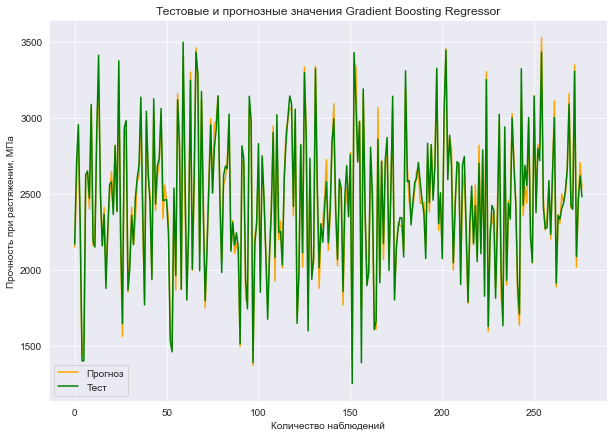

In [97]:
plt.figure(figsize = (10, 7))
plt.title("Тестовые и прогнозные значения Gradient Boosting Regressor")
plt.plot(y_pred_gbr, label = "Прогноз", color = "orange")
plt.plot(y_test_1.values, label = "Тест", color = "green")
plt.xlabel("Количество наблюдений")
plt.ylabel("Прочность при растяжении, МПа")
plt.legend()
plt.grid(True);

Градиентный бустинг с задачей справился в 97 % случаев.

Метод К ближайших соседей - K Neighbors Regressor - 5

In [98]:
knn = KNeighborsRegressor(n_neighbors=5)
knn.fit(x_train_1, y_train_1)
y_pred_knn = knn.predict(x_test_1)
mae_knr = mean_absolute_error(y_pred_knn, y_test_1)
mse_knn_elast = mean_squared_error(y_test_1,y_pred_knn)
print('K Neighbors Regressor Results Train:')
print("Test score: {:.2f}".format(knn.score(x_train_1, y_train_1)))# Скор для тренировочной выборки
print('K Neighbors Regressor Results:')
print('KNN_MAE: ', round(mean_absolute_error(y_test_1, y_pred_knn)))
print('KNN_MAPE: {:.2f}'.format(mean_absolute_percentage_error(y_test_1, y_pred_knn)))
print('KNN_MSE: {:.2f}'.format(mse_knn_elast))
print("KNN_RMSE: {:.2f}".format (np.sqrt(mse_knn_elast)))
print("Test score: {:.2f}".format(knn.score(x_test_1, y_test_1)))# Скор для тестовой выборки

K Neighbors Regressor Results Train:
Test score: 0.92
K Neighbors Regressor Results:
KNN_MAE:  120
KNN_MAPE: 0.05
KNN_MSE: 24594.48
KNN_RMSE: 156.83
Test score: 0.89


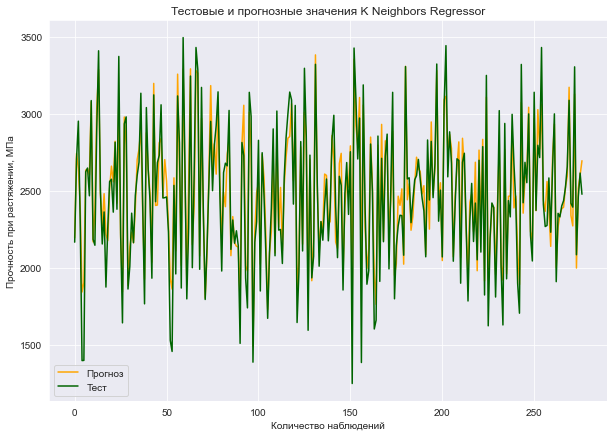

In [99]:
plt.figure(figsize = (10, 7))
plt.title("Тестовые и прогнозные значения K Neighbors Regressor")
plt.plot(y_pred_knn, label = "Прогноз", color = 'orange')
plt.plot(y_test_1.values, label = "Тест", color = 'darkgreen')
plt.xlabel("Количество наблюдений")
plt.ylabel("Прочность при растяжении, МПа")
plt.legend()
plt.grid(True);

Визуализация гистограммы распределения ошибки

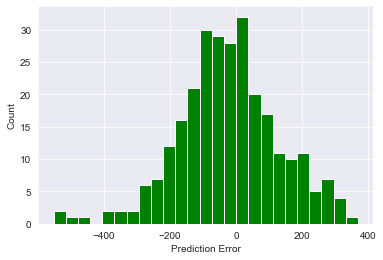

In [100]:
error = y_test_1 - y_pred_knn
plt.hist(error, bins = 25, color = "g")
plt.xlabel('Prediction Error')
_ = plt.ylabel('Count')

Деревья решений - Decision Tree Regressor - 6

In [101]:
dtr = DecisionTreeRegressor()
dtr.fit(x_train_1, y_train_1.values)
y_pred_dtr = dtr.predict(x_test_1)
mae_dtr = mean_absolute_error(y_pred_dtr, y_test_1)
mse_dtr_elast = mean_squared_error(y_test_1,y_pred_dtr)
print('Decision Tree Regressor Results Train:')
print("Test score: {:.2f}".format(knn.score(x_train_1, y_train_1)))# Скор для тренировочной выборки
print('Decision Tree Regressor Results:')
print('DTR_MAE: ', round(mean_absolute_error(y_test_1, y_pred_dtr)))
print('DTR_MSE: {:.2f}'.format(mse_dtr_elast))
print("DTR_RMSE: {:.2f}".format (np.sqrt(mse_dtr_elast)))
print('DTR_MAPE: {:.2f}'.format(mean_absolute_percentage_error(y_test_1, y_pred_dtr)))
print("Test score: {:.2f}".format(dtr.score(x_test_1, y_test_1)))# Скор для тестовой выборки

Decision Tree Regressor Results Train:
Test score: 0.92
Decision Tree Regressor Results:
DTR_MAE:  110
DTR_MSE: 19773.42
DTR_RMSE: 140.62
DTR_MAPE: 0.05
Test score: 0.91


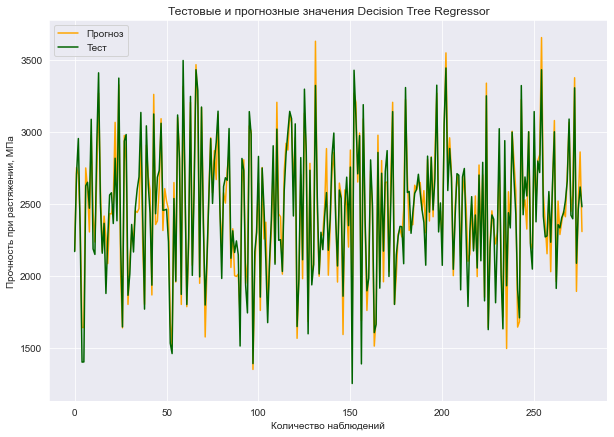

In [102]:
plt.figure(figsize = (10, 7))
plt.title("Тестовые и прогнозные значения Decision Tree Regressor")
plt.plot(y_pred_dtr, label = "Прогноз", color = 'orange')
plt.plot(y_test_1.values, label = "Тест", color = 'darkgreen')
plt.xlabel("Количество наблюдений")
plt.ylabel("Прочность при растяжении, МПа")
plt.legend()
plt.grid(True);

Стохастический градиентный спуск (SGD) - Stochastic Gradient Descent Regressor - 7 

In [103]:
sdg = SGDRegressor()
sdg.fit(x_train_1, y_train_1)
y_pred_sdg = sdg.predict(x_test_1)
mae_sdg = mean_absolute_error(y_pred_sdg, y_test_1)
mse_sdg_elast = mean_squared_error(y_test_1,y_pred_sdg)
print('Stochastic Gradient Descent Regressor Results Train:')
print("Test score: {:.2f}".format(sdg.score(x_train_1, y_train_1)))# Скор для тренировочной выборки
print('Stochastic Gradient Descent Regressor Results:')
print('SGD_MAE: ', round(mean_absolute_error(y_test_1, y_pred_sdg)))
print('SGD_MSE: {:.2f}'.format(mse_sdg_elast))
print("SGD_RMSE: {:.2f}".format (np.sqrt(mse_sdg_elast)))
print('SGD_MAPE: {:.2f}'.format(mean_absolute_percentage_error(y_test_1, y_pred_sdg)))
print("Test score: {:.2f}".format(sdg.score(x_test_1, y_test_1)))# Скор для тестовой выборки

Stochastic Gradient Descent Regressor Results Train:
Test score: 0.72
Stochastic Gradient Descent Regressor Results:
SGD_MAE:  191
SGD_MSE: 57328.91
SGD_RMSE: 239.43
SGD_MAPE: 0.08
Test score: 0.73


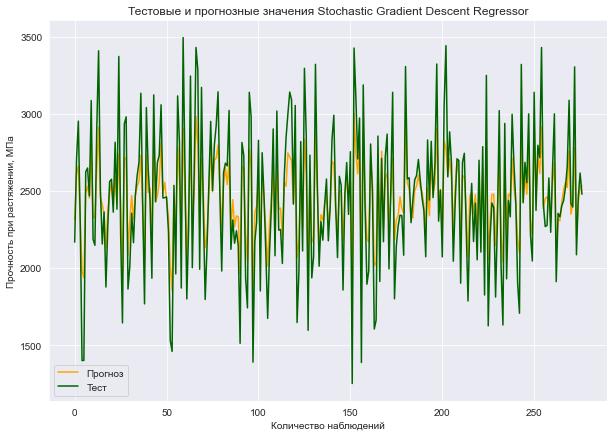

In [104]:
plt.figure(figsize = (10, 7))
plt.title("Тестовые и прогнозные значения Stochastic Gradient Descent Regressor")
plt.plot(y_pred_sdg, label = "Прогноз", color = 'orange')
plt.plot(y_test_1.values, label = "Тест", color = 'darkgreen')
plt.xlabel("Количество наблюдений")
plt.ylabel("Прочность при растяжении, МПа")
plt.legend()
plt.grid(True);

Многослойный перцептрон - Multi-layer Perceptron regressor - 8

In [105]:
mlp = MLPRegressor(random_state = 1, max_iter = 500)
mlp.fit(x_train_1, y_train_1)
y_pred_mlp = mlp.predict(x_test_1)
mae_mlp = mean_absolute_error(y_pred_mlp, y_test_1)
mse_mlp_elast = mean_squared_error(y_test_1,y_pred_mlp)
print('Multi-layer Perceptron regressor Results Train:')
print("Test score: {:.2f}".format(mlp.score(x_train_1, y_train_1)))# Скор для тренировочной выборки
print('Multi-layer Perceptron regressor Results:')
print('SGD_MAE: ', round(mean_absolute_error(y_test_1, y_pred_mlp)))
print('SGD_MAPE: {:.2f}'.format(mean_absolute_percentage_error(y_test_1, y_pred_mlp)))
print('SGD_MSE: {:.2f}'.format(mse_mlp_elast))
print("SGD_RMSE: {:.2f}".format (np.sqrt(mse_mlp_elast)))
print("Test score: {:.2f}".format(mlp.score(x_test_1, y_test_1)))# Скор для тестовой выборки

Multi-layer Perceptron regressor Results Train:
Test score: -13.05
Multi-layer Perceptron regressor Results:
SGD_MAE:  1615
SGD_MAPE: 0.64
SGD_MSE: 2867642.63
SGD_RMSE: 1693.41
Test score: -12.40


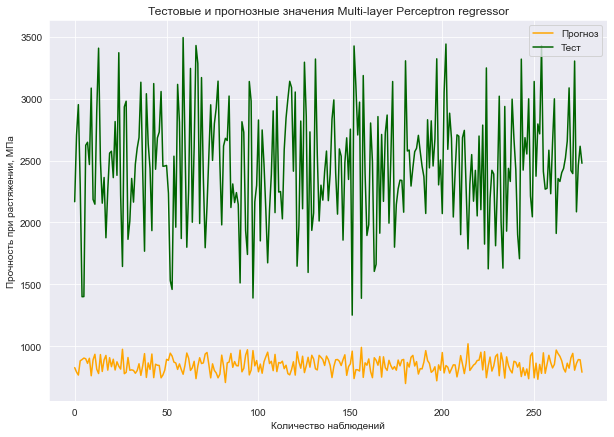

In [106]:
plt.figure(figsize = (10, 7))
plt.title("Тестовые и прогнозные значения Multi-layer Perceptron regressor")
plt.plot(y_pred_mlp, label = "Прогноз", color = 'orange')
plt.plot(y_test_1.values, label = "Тест", color = 'darkgreen')
plt.xlabel("Количество наблюдений")
plt.ylabel("Прочность при растяжении, МПа")
plt.legend()
plt.grid(True);

Лассо регрессия - the Lasso - 9

In [107]:
clf = linear_model.Lasso(alpha=0.1)
clf.fit(x_train_1, y_train_1)
y_pred_clf = clf.predict(x_test_1)
mae_clf = mean_absolute_error(y_pred_clf, y_test_1)
mse_clf_elast = mean_squared_error(y_test_1,y_pred_clf)
print('Lasso regressor Results Train:')
print("Test score: {:.2f}".format(clf.score(x_train_1, y_train_1)))# Скор для тренировочной выборки
print('Lasso regressor Results:')
print('SGD_MAE: ', round(mean_absolute_error(y_test_1, y_pred_clf)))
print('SGD_MAPE: {:.2f}'.format(mean_absolute_percentage_error(y_test_1, y_pred_clf)))
print('SGD_MSE: {:.2f}'.format(mse_clf_elast))
print("SGD_RMSE: {:.2f}".format (np.sqrt(mse_clf_elast)))
print("Test score: {:.2f}".format(clf.score(x_test_1, y_test_1)))# Скор для тестовой выборки

Lasso regressor Results Train:
Test score: 0.95
Lasso regressor Results:
SGD_MAE:  71
SGD_MAPE: 0.03
SGD_MSE: 8120.07
SGD_RMSE: 90.11
Test score: 0.96


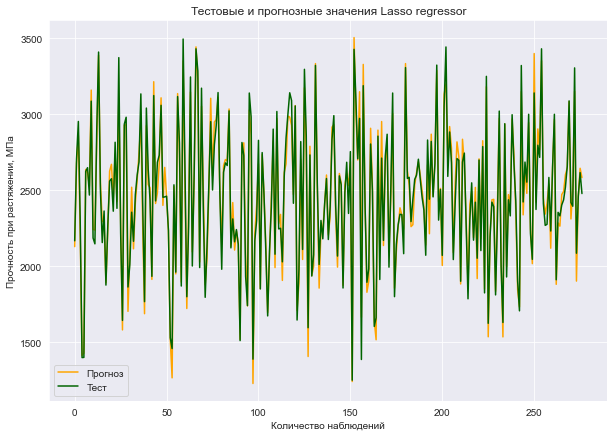

In [108]:
plt.figure(figsize = (10, 7))
plt.title("Тестовые и прогнозные значения Lasso regressor")
plt.plot(y_pred_clf, label = "Прогноз", color = 'orange')
plt.plot(y_test_1.values, label = "Тест", color = 'darkgreen')
plt.xlabel("Количество наблюдений")
plt.ylabel("Прочность при растяжении, МПа")
plt.legend()
plt.grid(True);

сравним наши модели по метрике МАЕ

In [109]:
mae_df = {'Регрессор': ['Support Vector', 'RandomForest', 'Linear Regression', 'GradientBoosting', 'KNeighbors', 'DecisionTree', 'SGD', 'MLP', 'Lasso'], 'MAE': [mae_svr, mae_rfr, mae_lr, mae_gbr, mae_knr, mae_dtr, mae_sdg, mae_mlp, mae_clf]}
mae_df = pd.DataFrame(mae_df)

In [110]:
mae_df

,Регрессор,MAE
0,Support Vector,76.326686
1,RandomForest,81.813817
2,Linear Regression,64.302274
3,GradientBoosting,61.284284
4,KNeighbors,120.264255
5,DecisionTree,110.241849
6,SGD,190.986579
7,MLP,1615.329938
8,Lasso,70.776158


Поиск оптимальных гиперпараметров. В машинном обучении гиперпараметрами называют параметры алгоритмов, значения которых устанавливаются перед запуском процесса обучения. В этом смысле они и отличаются от обычных параметров, вычисляемых в процессе обучения. Гиперпараметры используются для управления процессом обучения. Один из способов настройки гиперпараметров состоит в том, чтобы заставить компьютер попробовать все возможные комбинации значений параметров. Для этого используем модуль GridSearchCV из библиотеки Scikit Learn. Попытаемся найти наилучшую комбинацию гиперпараметров для построения классификатора для нашего набора данных. Метод GridSearch: ПЛЮСЫ: Этот метод получит требуемые оптимальные гиперпараметры. МИНУСЫ: Операция является исчерпывающей. Если диапазон или число гиперпараметров велики, то вероятности могут исчисляться миллионами, и на завершение потребуется довольно много времени.

Проведем поиск по сетке гиперпараметров с перекрестной проверкой, количество блоков равно 10 (cv = 10), для 
модели случайного леса - Random Forest Regressor - 2

In [111]:
parametrs = { 'n_estimators': [200, 300],
              'max_depth': [9, 15],
              'max_features': ['auto'],
              'criterion': ['mse'] }
grid = GridSearchCV(estimator = rfr, param_grid = parametrs, cv = 10)
grid.fit(x_train_1, y_train_1)
grid.best_params_

{'criterion': 'mse',
 'max_depth': 15,
 'max_features': 'auto',
 'n_estimators': 300}

Выводим гиперпараметры для оптимальной модели

In [112]:
print(grid.best_estimator_)
knr_upr = grid.best_estimator_
print(f'R2-score RFR для прочности при растяжении, МПа: {knr_upr.score(x_test_1, y_test_1).round(3)}')

RandomForestRegressor(criterion='mse', max_depth=15, max_features='auto',
                      n_estimators=300, random_state=33)
R2-score RFR для прочности при растяжении, МПа: 0.959


подставим оптимальные гиперпараметры в нашу модель случайного леса

Обучаем модель.
Оцениваем точность на тестовом наборе

In [113]:
rfr_grid = RandomForestRegressor(n_estimators = 200, criterion = 'mse', max_depth = 15, max_features = 'auto')
rfr_grid.fit(x_train_1, y_train_1)
predictions_rfr_grid = rfr_grid.predict(x_test_1)
mae_rfr_grid = mean_absolute_error(predictions_rfr_grid, y_test_1)
mae_rfr_grid

73.67602922609855

In [114]:
new_row_in_mae_df = {'Регрессор': 'RandomForest_GridSearchCV', 'MAE': mae_rfr_grid}
mae_df = mae_df.append(new_row_in_mae_df, ignore_index=True)

поиск гипермараметров не дал улучшений для уже имеющейся модели RandomForestRegressor
вероятно, нужно указывать больше вариаций параметров при работе с GridSearchCV

In [115]:
mae_df

,Регрессор,MAE
0,Support Vector,76.326686
1,RandomForest,81.813817
2,Linear Regression,64.302274
3,GradientBoosting,61.284284
4,KNeighbors,120.264255
5,DecisionTree,110.241849
6,SGD,190.986579
7,MLP,1615.329938
8,Lasso,70.776158
9,RandomForest_GridSearchCV,73.676029


Проведем поиск по сетке гиперпараметров с перекрестной проверкой, количество блоков равно 10 (cv = 10), для 
Метода К ближайших соседей - K Neighbors Regressor - 5

Запустим обучение модели. В качестве оценки модели будем использовать коэффициент детерминации (R^2)
Если R2<0, это значит, что разработанная модель даёт прогноз даже хуже, чем простое усреднение.

In [116]:
knn = KNeighborsRegressor()
knn_params = {'n_neighbors' : range(1, 301, 2),
 'weights' : ['uniform', 'distance'],
 'algorithm' : ['auto', 'ball_tree', 'kd_tree', 'brute']
 }

gs = GridSearchCV(knn, knn_params, cv = 10, verbose = 1, n_jobs =-1, scoring = 'r2')
gs.fit(x_train_1, y_train_1)
knn_3 = gs.best_estimator_
gs.best_params_

Fitting 10 folds for each of 1200 candidates, totalling 12000 fits


{'algorithm': 'auto', 'n_neighbors': 5, 'weights': 'distance'}

Выводим гиперпараметры для оптимальной модели

In [117]:
print(gs.best_estimator_)
gs1 = gs.best_estimator_
print(f'R2-score KNR для прочности при растяжении, МПа: {gs1.score(x_test_1, y_test_1).round(3)}')

KNeighborsRegressor(weights='distance')
R2-score KNR для прочности при растяжении, МПа: 0.89


подставим оптимальные гиперпараметры в нашу модель метода к ближайших соседей

Обучаем модель.
Оцениваем точность на тестовом наборе

In [118]:
knn_grid = KNeighborsRegressor(algorithm = 'brute', n_neighbors = 7, weights = 'distance')

knn_grid.fit(x_train_1, y_train_1)
predictions_knn_grid = knn_grid.predict(x_test_1)

mae_knn_grid = mean_absolute_error(predictions_knn_grid, y_test_1)
mae_knn_grid

114.70924901457768

In [119]:
new_row_in_mae_df = {'Регрессор': 'KNeighbors_GridSearchCV', 'MAE': mae_knn_grid}
mae_df = mae_df.append(new_row_in_mae_df, ignore_index=True)
mae_df

,Регрессор,MAE
0,Support Vector,76.326686
1,RandomForest,81.813817
2,Linear Regression,64.302274
3,GradientBoosting,61.284284
4,KNeighbors,120.264255
5,DecisionTree,110.241849
6,SGD,190.986579
7,MLP,1615.329938
8,Lasso,70.776158
9,RandomForest_GridSearchCV,73.676029


Проведем поиск по сетке гиперпараметров с перекрестной проверкой, количество блоков равно 10 (cv = 10), для 
Деревья решений - Decision Tree Regressor - 6

Запустим обучение модели. В качестве оценки модели будем использовать коэффициент детерминации (R^2)
Если R2<0, это значит, что разработанная модель даёт прогноз даже хуже, чем простое усреднение.

In [120]:
criterion = ['squared_error', 'friedman_mse', 'absolute_error', 'poisson']
splitter = ['best', 'random']
max_depth = [3,5,7,9,11]
min_samples_leaf = [100,150,200]
min_samples_split = [200,250,300]
max_features = ['auto', 'sqrt', 'log2']
param_grid = {'criterion': criterion,
 'splitter': splitter,
 'max_depth': max_depth,
 'min_samples_split': min_samples_split,
 'min_samples_leaf': min_samples_leaf,
 'max_features': max_features}

gs4 = GridSearchCV(dtr, param_grid, cv = 10, verbose = 1, n_jobs =-1, scoring = 'r2')
gs4.fit(x_train_1, y_train_1)
dtr_3 = gs4.best_estimator_
gs.best_params_

Fitting 10 folds for each of 1080 candidates, totalling 10800 fits


{'algorithm': 'auto', 'n_neighbors': 5, 'weights': 'distance'}

Выводим гиперпараметры для оптимальной модели

In [121]:
print(gs4.best_estimator_)
gs1 = gs4.best_estimator_
print(f'R2-score DTR для прочности при растяжении, МПа: {gs4.score(x_test_1, y_test_1).round(3)}')

DecisionTreeRegressor(criterion='poisson', max_depth=7, max_features='auto',
                      min_samples_leaf=100, min_samples_split=200)
R2-score DTR для прочности при растяжении, МПа: 0.834


подставим оптимальные гиперпараметры в нашу модель метода деревья решений

Обучаем модель.
Оцениваем точность на тестовом наборе

In [122]:
dtr_grid = DecisionTreeRegressor(criterion = 'poisson', max_depth = 7, max_features = 'auto',
 min_samples_leaf = 100, min_samples_split = 250)

dtr_grid.fit(x_train_1, y_train_1)
predictions_dtr_grid = dtr_grid.predict(x_test_1)

mae_dtr_grid = mean_absolute_error(predictions_dtr_grid, y_test_1)
mae_dtr_grid

165.79514541472096

In [123]:
new_row_in_mae_df = {'Регрессор': 'DecisionTree_GridSearchCV', 'MAE': mae_dtr_grid}
mae_df = mae_df.append(new_row_in_mae_df, ignore_index = True)
mae_df

,Регрессор,MAE
0,Support Vector,76.326686
1,RandomForest,81.813817
2,Linear Regression,64.302274
3,GradientBoosting,61.284284
4,KNeighbors,120.264255
5,DecisionTree,110.241849
6,SGD,190.986579
7,MLP,1615.329938
8,Lasso,70.776158
9,RandomForest_GridSearchCV,73.676029


In [124]:
pipe = Pipeline([('preprocessing', StandardScaler()), ('regressor', SVR())])
param_grid = [
{'regressor': [SVR()], 'preprocessing': [StandardScaler(), MinMaxScaler(), None],
'regressor__gamma': [0.001, 0.01, 0.1, 1, 10, 100],
'regressor__C': [0.001, 0.01, 0.1, 1, 10, 100]},
{'regressor': [RandomForestRegressor(n_estimators = 100)],
'preprocessing': [StandardScaler(), MinMaxScaler(), None]},
{'regressor': [LinearRegression()], 'preprocessing': [StandardScaler(), MinMaxScaler(), None]},
{'regressor': [GradientBoostingRegressor()], 'preprocessing': [StandardScaler(), MinMaxScaler(), None]},
{'regressor': [KNeighborsRegressor()], 'preprocessing': [StandardScaler(), MinMaxScaler(), None]},
{'regressor': [DecisionTreeRegressor()], 'preprocessing': [StandardScaler(), MinMaxScaler(), None]},
{'regressor': [SGDRegressor()], 'preprocessing': [StandardScaler(), MinMaxScaler(), None]},
{'regressor': [MLPRegressor(random_state = 1, max_iter = 500)], 'preprocessing': [StandardScaler(), MinMaxScaler(), None]},
{'regressor': [linear_model.Lasso(alpha = 0.1)], 'preprocessing': [StandardScaler(), MinMaxScaler(), None]},]
grid = GridSearchCV(pipe, param_grid, cv = 10)
grid.fit(x_train_1, np.ravel(y_train_1))
print("Наилучшие параметры:\n{}\n".format(grid.best_params_))
print("Наилучшее значение правильности перекрестной проверки: {:.2f}".format(grid.best_score_))
print("Правильность на тестовом наборе: {:.2f}".format(grid.score(x_test_1, y_test_1)))

Наилучшие параметры:
{'preprocessing': StandardScaler(), 'regressor': GradientBoostingRegressor()}

Наилучшее значение правильности перекрестной проверки: 0.97
Правильность на тестовом наборе: 0.97


In [125]:
print("Наилучшая модель:\n{}".format(grid.best_estimator_))

Наилучшая модель:
Pipeline(steps=[('preprocessing', StandardScaler()),
                ('regressor', GradientBoostingRegressor())])
